# <h1 align="center">COSC2753 - Machine Learning</h1>

<h2 align="center">Group Machine Learning Project</h2>

---

### 👥 Group Members:
- Ngo Van Tai (S3974892)  
- Huynh Thai Duong (S)
- Huynh Tan Phat (S)
- Duong Minh Tri (S)

---


# CONVENTIONAL RULE

- Tất cả tên biến đều là snake case (variable_one)
- Tất cả function đều phải có docstring (có thể nhờ GPT rồi parapharse lại)
- Tất cả import library thì phải được đặt ở đầu file với comment rõ ràng vào cái phần của nó (ở chỗ import neccessary librariess)
- Hàm nào lặp lại quá nhiều lần thì phải define helper function (cùng với docstring) of course

# TABLE OF CONTENT

# I. IMPORT NECESSARY LIBRARIES

In [ ]:
# Data manipulation libraries
import pandas as pd
import numpy as np
import random
import cv2
import os
from tqdm import tqdm
from collections import defaultdict
import imagehash

# Data visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Image Visualization
import matplotlib.image as mpimg
from PIL import Image

# Data preprocessing
from sklearn.model_selection import train_test_split

# Sklearn Library
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    precision_score,
    recall_score,
)


## Import Tensorflow for TensorFlow ≤ 2.12

In [ ]:
# # Deep learning libraries
# import tensorflow as tf
# from tensorflow.keras import layers, models
# from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Flatten, Dropout
# from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.initializers import GlorotUniform
# from tensorflow.keras.layers import Conv2D, MaxPooling2D
# from tensorflow.keras.models import load_model

## Using Keras for Keras 3.x with TensorFlow ≥ 2.13

In [21]:
# Deep learning libraries
import tensorflow as tf
from keras import Sequential, layers, models, Input
from keras.regularizers import l2
from keras.layers import Dense, Flatten, Dropout, Conv2D, MaxPooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.src.legacy.preprocessing.image import ImageDataGenerator
from keras.initializers import GlorotUniform

## 1) Define Some Helper Functions

In [18]:
def print_header(content, padding=10, width=None, tabs=False):
    """
    Prints a header wrapped inside a box.

    Parameters:
    - content: Text to display as header (automatically uppercase)
    - padding: Spaces on each side of the content inside the box
    - width: Optional fixed width for the entire box. If None, adjusts to content size.
    - tabs: If true, adds the spacing `\t`to center of the box
    """
    content = content.upper()
    inner_width = len(content) + (padding * 2)
    box_width = width if width and width > inner_width else inner_width

    top_bottom = "+" + "-" * (box_width + 2) + "+"
    padded_content = "| " + content.center(box_width) + " |"
    prefix = "\t" * 3 if tabs else ""

    print(f"{prefix}{top_bottom}")
    print(f"{prefix}{padded_content}")
    print(f"{prefix}{top_bottom}")

In [8]:
def visualize_images(df, num_images=5, title=None, figsize=(15, 3)):
    """
    Visualize images from dataset

    Parameters:
    - df: DataFrame metadata
    - num_images: Number of images to display
    - title: Optional title for the entire figure
    - figsize: Size of the figure as (width, height) tuple
    """

    # Get image paths from the DataFrame
    image_paths = df["image_path"].tolist()
    num_images = len(image_paths)

    fig, axes = plt.subplots(1, num_images, figsize=figsize, facecolor="white")

    # Handle case of a single image
    if num_images == 1:
        axes = [axes]

    for idx, (_, row) in enumerate(df.iterrows()):
        file_path = row["image_path"]

        # Build title based on metadata
        title_parts = [f"ID: {row['image_id']}"]
        for col in row.index:
            if col not in ["image_id", "image_path"]:
                title_parts.append(f"{col}: {row[col]}")
        img_title = "\n".join(title_parts)

        try:
            img = mpimg.imread(file_path)
            axes[idx].imshow(img)
            axes[idx].axis("off")
            axes[idx].set_title(img_title, fontsize=9)
        except FileNotFoundError:
            print(f"Image not found: {file_path}")
            axes[idx].text(0.5, 0.5, "Image not found", ha="center", va="center")
            axes[idx].axis("off")

    # Add overall title if availabel
    if title:
        plt.suptitle(title, fontsize=14, y=1.01)
        plt.subplots_adjust(top=0.85)

    plt.tight_layout()
    plt.show()

# II. LOAD DATASET

## 1. Loading Dataset

In [7]:
original_df = pd.read_csv('./inputs/meta_train.csv')

# III. EXPLORATORY DATA ANALYSIS (EDA)

## 1) Dataset Overview

This is the description of each column in the dataset

| Column Name | Description |
|-------------|-------------|
| `image_id`  | Unique identifier for each image, matching the file names (.jpg) in the `train_images` directory |
| `label`     | The category of paddy disease. There are ten classes, including one for healthy (normal) plant |
| `variety`   | The paddy variety name |
| `age`       | The age of the paddy in days |

In [9]:
print_header('Dataset Overview')
original_df

+--------------------------------------+
|           DATASET OVERVIEW           |
+--------------------------------------+


,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45
...,...,...,...,...
10402,107607.jpg,tungro,Zonal,55
10403,107811.jpg,tungro,Zonal,55
10404,108547.jpg,tungro,Zonal,55
10405,110245.jpg,tungro,Zonal,55


## 2) Add `image_path` column

In the given dataset, the image path for the dataset is the combination of `label` and `image_id`. To simplify the development process, we created the `image_path` column for the dataset so it is easier to extract the image path.

In [16]:
train_img_dir = "./inputs/train_images"

# Copy original dataframe
df = original_df.copy()

df["image_path"] = df.apply(
    lambda row: os.path.join(train_img_dir, row["label"], row["image_id"]), axis=1
)

In [12]:
print_header("Dataset Overview After adding `image_path` column")
df['image_path']

+-----------------------------------------------------------------------+
|           DATASET OVERVIEW AFTER ADDING `IMAGE_PATH` COLUMN           |
+-----------------------------------------------------------------------+


0        ./inputs/train_images/bacterial_leaf_blight/10...
1        ./inputs/train_images/bacterial_leaf_blight/10...
2        ./inputs/train_images/bacterial_leaf_blight/10...
3        ./inputs/train_images/bacterial_leaf_blight/10...
4        ./inputs/train_images/bacterial_leaf_blight/10...
                               ...                        
10402              ./inputs/train_images/tungro/107607.jpg
10403              ./inputs/train_images/tungro/107811.jpg
10404              ./inputs/train_images/tungro/108547.jpg
10405              ./inputs/train_images/tungro/110245.jpg
10406              ./inputs/train_images/tungro/110381.jpg
Name: image_path, Length: 10407, dtype: object

## 2) Data Shape

In the initial observation, the given dataset contains over 10,000 rows, and four different column (excluding `image_path` column).

In [14]:
print_header("Data Shape")

print("Number of Rows: ", df.shape[0])
print("Number of Columns: ", df.shape[1])

+--------------------------------+
|           DATA SHAPE           |
+--------------------------------+
Number of Rows:  10407
Number of Columns:  5


## 3) Duplicated & Null Data

There is no duplicated or null data appearing in the given dataset. However, we need to compute image hashes to identify any duplicate images.

In [15]:
print_header("Missing Data")
df.isnull().sum()

+----------------------------------+
|           MISSING DATA           |
+----------------------------------+


image_id      0
label         0
variety       0
age           0
image_path    0
dtype: int64

In [15]:
print_header("Duplicated Data")
df.duplicated().sum()

+-------------------------------------+
|           DUPLICATED DATA           |
+-------------------------------------+


0

In [16]:
print_header("Data Shape")

print("Number of Rows: ", df.shape[0])
print("Number of Columns: ", df.shape[1])

+--------------------------------+
|           DATA SHAPE           |
+--------------------------------+
Number of Rows:  10407
Number of Columns:  5


## 4) Exploring Columns

### 4.1) Label Column

There are 10 classes in the `label` column, including nine disease classes and one for healthy (normal) plant:

| Class                     | Explanation |
|--------------------------|-------------|
| `bacterial_leaf_blight`  | The bacterial disease results in dark lesions with yellow borders that cause leaf tissue death |
| `bacterial_leaf_streak`  | The bacterial infection results in leaf tissue death through the formation of streaks or lesions |
| `bacterial_panicle_blight` | The bacterial disease targets rice panicle structures by killing flower clusters which leads to decreased grain yields |
| `blast`                  | Blast is a fungal disease that causes dark lesions on leaves, necks, and panicles of rice, and can lead to plant death |
| `brown_spot`             | The disease produces brown circular lesions with yellowish margins on rice leaves which decrease photosynthesis and growth |
| `dead_heart`             | Stem borer infestation leads to this condition when the insect pests damage the plant's growing point which results in stunted growth or plant death |
| `downy_mildew`           | A fungal disease that causes yellowing of leaves with white fungal growth on the undersides, often reducing plant vigor |
| `hispa`                  | The hispa beetle infestation results in damage to rice plants through leaf consumption which leads to yield reduction |
| `normal`                 | This refers to healthy plants without any visible signs of disease or pest damage |
| `tungro`                 | A viral disease transmitted by leafhoppers that causes yellowing and stunting of rice plants, leading to yield loss |


In [16]:
unique_labels = df["label"].nunique()

print_header("Paddy Labels Overview")
print(f"The dataset contains {unique_labels} unique paddy labels.\n")

# Display the list of unique labels
print_header("List of Paddy Labels")
print("Here are the unique paddy varieties in the dataset:")
for idx, label in enumerate(df["label"].unique().tolist(), start=1):
    print(f"{idx}) {label}")

+-------------------------------------------+
|           PADDY LABELS OVERVIEW           |
+-------------------------------------------+
The dataset contains 10 unique paddy labels.

+------------------------------------------+
|           LIST OF PADDY LABELS           |
+------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) bacterial_leaf_blight
2) bacterial_leaf_streak
3) bacterial_panicle_blight
4) blast
5) brown_spot
6) dead_heart
7) downy_mildew
8) hispa
9) normal
10) tungro


### 4.2) Variety Column

| Variety        | Explanation |
|----------------|-------------|
| `ADT45`        | ADT45 is a popular high yielding variety of rice from Tamil Nadu (India), which is known for its excellent grain quality and good resistance to pests and diseases |
| `IR20`         | IR20 is a widely grown rice type developed by the International Rice Research Institute, known for its resistance to drought and its good yield |
| `KarnatakaPonni` | KarnatakaPonni is a traditional rice variety grown in the southern region of India, particularly known for its taste and aroma |
| `Onthanel`     | Onthanel is a variety known for its good cooking qualities and higher resistance to pests, widely cultivated in some parts of India |
| `Ponni`        | Ponni is one of the most famous rice varieties in India, renowned for its smooth texture and aroma, widely used in South Indian cuisine |
| `Surya`        | Surya is a high-yielding variety known for its long grain and excellent cooking quality, commonly grown in Indian rice fields |
| `Zonal`        | Zonal is a rice variety developed for specific climatic zones, offering adaptability to different growing conditions |
| `AndraPonni`   | AndraPonni is a popular variety of rice from Andhra Pradesh, known for its fine texture and aroma |
| `AtchayaPonni` | AtchayaPonni is another aromatic and high-yielding variety, often used in South Indian cooking due to its distinct fragrance and taste |
| `RR`           | RR is a high-yielding variety of rice developed for various agro-climatic conditions, known for its disease resistance and good grain quality |


In [17]:
unique_variety = df["variety"].nunique()

print_header("Paddy Variety Overview")
print(f"The dataset contains {unique_variety} unique paddy varieties.\n")

# Display the list of unique variety
print_header("List of Paddy Varieties")
print("Here are the unique paddy varieties in the dataset:")
for idx, variety in enumerate(df["variety"].unique().tolist(), start=1):
    print(f"{idx}) {variety}")

+--------------------------------------------+
|           PADDY VARIETY OVERVIEW           |
+--------------------------------------------+
The dataset contains 10 unique paddy varieties.

+---------------------------------------------+
|           LIST OF PADDY VARIETIES           |
+---------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) ADT45
2) IR20
3) KarnatakaPonni
4) Onthanel
5) Ponni
6) Surya
7) Zonal
8) AndraPonni
9) AtchayaPonni
10) RR


### 4.3) Age Columns

| Statistic               | Value |  Interpretation                                               |
|-------------------------|-------|---------------------------------------------------------------|
| **Mean**                | 64.04 | On average, plants are ~64 days old—placing most in the **vegetative (0–65 days)** or **early reproductive (65–100 days)** phase [1]. |
| **Standard Deviation (std)**  | 8.96  | The standard deviation of 8.96 indicates a moderate level of variability in the paddy age. While most plants are similar in age, the spread indicates some variation, likely due to factors like planting times or environmental conditions. |
| **Minimum Age**         | 45    | The youngest (45 days) is solidly in the vegetative phase, likely from early transplanting or faster growth. This could suggest that several plants are growing faster due to early planting or good conditions. |
| **Maximum Age**         | 82    | The oldest paddy plant in the dataset is 82 days old. This shows that some plants mature later, possibly due to delayed planting or growth issues. |

![paddy_phase_image](./images/paddy_phases.jpg)

Figure 1: Rice (paddy) growth phases mapped to days after transplanting. Source: ResearchGate [1].

Img Source: https://www.researchgate.net/publication/339052399_Machine_learning_and_big_data_techniques_for_satellite-based_rice_phenology_monitoring


In [19]:
sorted_ages = sorted(df["age"].unique().tolist())

print_header("Paddy Ages Overview")
print(f"The dataset contains {len(sorted_ages)} unique paddy ages.\n")

print_header("List of Paddy Ages")
print("Here are the unique paddy ages in the dataset:")
for idx, age in enumerate(sorted_ages, start=1):
    print(f"{idx}) {age}")


+-----------------------------------------+
|           PADDY AGES OVERVIEW           |
+-----------------------------------------+
The dataset contains 18 unique paddy ages.

+----------------------------------------+
|           LIST OF PADDY AGES           |
+----------------------------------------+
Here are the unique paddy ages in the dataset:
1) 45
2) 47
3) 50
4) 55
5) 57
6) 60
7) 62
8) 65
9) 66
10) 67
11) 68
12) 70
13) 72
14) 73
15) 75
16) 77
17) 80
18) 82


In [20]:
print_header("Column `Age` Description")
df["age"].describe()

+----------------------------------------------+
|           COLUMN `AGE` DESCRIPTION           |
+----------------------------------------------+


count    10407.000000
mean        64.043624
std          8.958830
min         45.000000
25%         60.000000
50%         67.000000
75%         70.000000
max         82.000000
Name: age, dtype: float64

## 5) Image Visualization 

### 5.1) Helper Function

In [21]:
def visualize_category_distribution(df, column_name):
    """
    Visualizes the distribution of categories from a specified column in the provided DataFrame.

    Parameters:
    - df: pandas DataFrame containing the column to visualize.
    - column_name: The column name whose distribution will be visualized.
    """
    # Calculate the frequency of each category in the specified column
    category_counts = df[column_name].value_counts()

    # Create a figure with two side-by-side plots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10), facecolor="white")

    # Plot a pie chart in the first subplot
    color_palette = sns.color_palette("coolwarm")
    sns.set_palette(color_palette)
    axes[0].pie(
        category_counts, labels=category_counts.index, autopct="%1.1f%%", startangle=140
    )
    axes[0].set_title(f"{column_name} Distribution")

    # Plot a bar chart in the second subplot with the hue parameter
    sns.barplot(
        x=category_counts.index,
        y=category_counts.values,
        ax=axes[1],
        hue=category_counts.index,
        palette="coolwarm",
        legend=False,
    )
    axes[1].set_title(f"{column_name} Counts")

    # Adjust layout to ensure no overlapping of elements
    plt.tight_layout()

    # Display the plots
    plt.show()

In [22]:
def plot_grouped_bar(
    df: pd.DataFrame,
    group_col: str,
    value_col: str,
    agg_func: str = "mean",
    title: str = "",
    x_label: str = "",
    y_label: str = "",
    sort: bool = True,
    ascending: bool = False,
    palette: str = "coolwarm",
    figsize: tuple = (10, 6),
):
    """
    Creates a bar plot of the aggregated value of a numeric column grouped by a categorical column.

    Parameters:
    - df: pandas DataFrame
    - group_col: column to group by (categorical)
    - value_col: column to aggregate (numeric)
    - agg_func: aggregation function ('mean', 'sum', 'count', etc.)
    - title: chart title
    - x_label: label for x-axis
    - y_label: label for y-axis
    - sort: whether to sort the result
    - ascending: sorting order
    - palette: seaborn color palette
    - figsize: tuple indicating figure size
    """

    # Group and aggregate
    grouped = df.groupby(group_col)[value_col].agg(agg_func)

    if sort:
        grouped = grouped.sort_values(ascending=ascending)

    # Plot
    plt.figure(figsize=figsize)
    sns.barplot(
        x=grouped.values,
        y=grouped.index,
        hue=grouped.index,
        dodge=False,
        legend=False,
        palette=palette,
    )
    plt.title(title or f"{agg_func.capitalize()} of {value_col} by {group_col}")
    plt.xlabel(x_label or f"{agg_func.capitalize()} {value_col}")
    plt.ylabel(y_label or group_col)
    plt.tight_layout()
    plt.show()

### 4.2) Labels Image Visualization

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_BLIGHT`           |
			+--------------------------------------------------------------------+


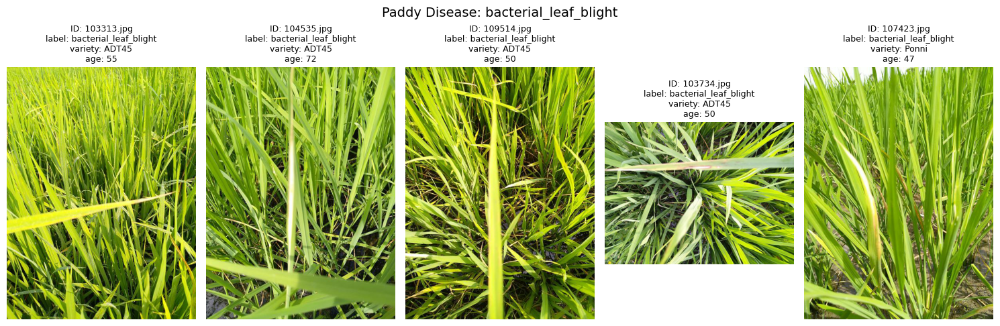

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_STREAK`           |
			+--------------------------------------------------------------------+


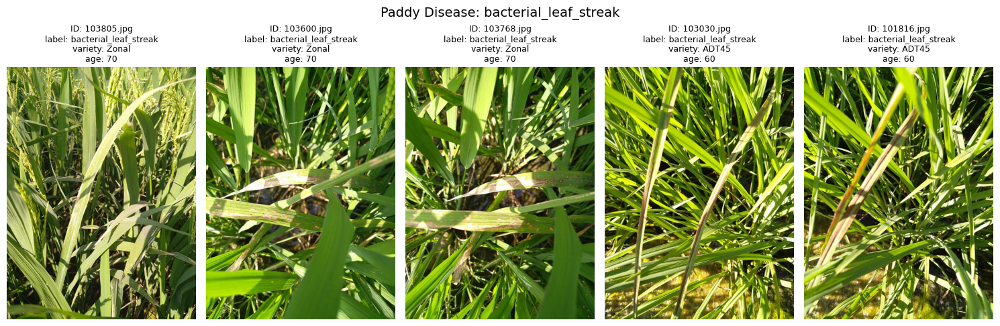

			+-----------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_PANICLE_BLIGHT`           |
			+-----------------------------------------------------------------------+


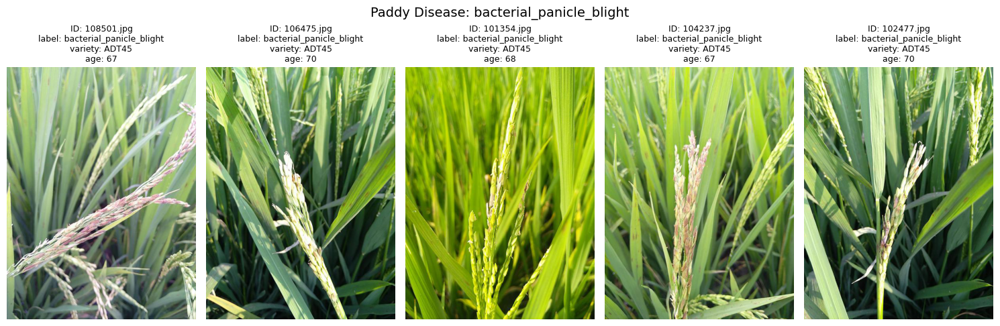

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BLAST`           |
			+----------------------------------------------------+


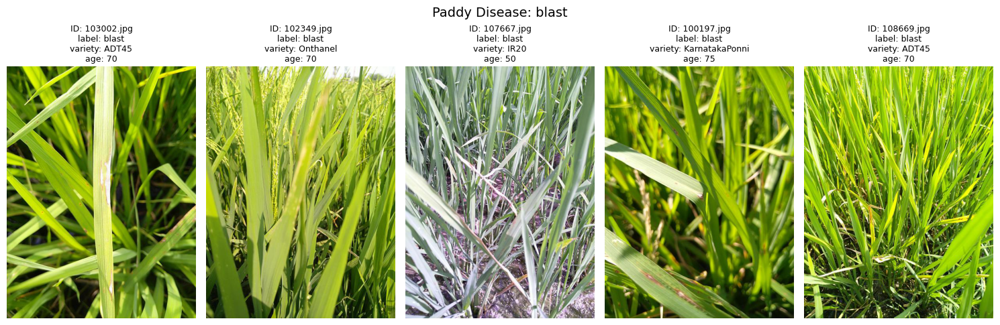

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BROWN_SPOT`           |
			+---------------------------------------------------------+


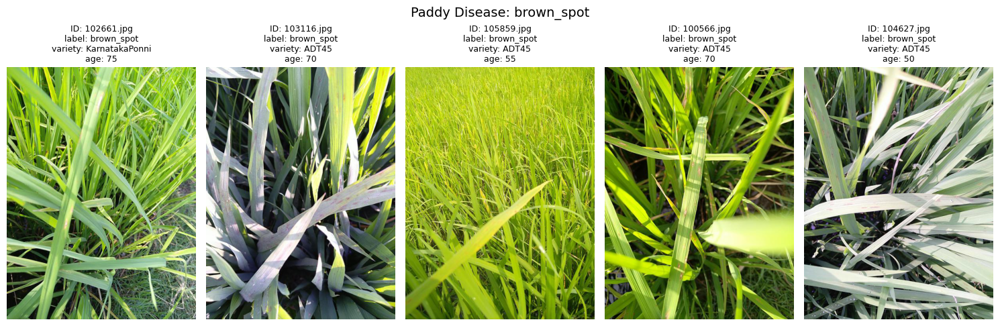

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DEAD_HEART`           |
			+---------------------------------------------------------+


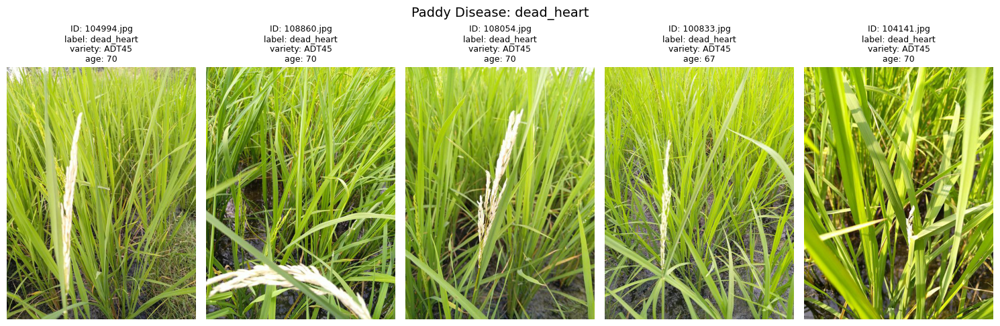

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DOWNY_MILDEW`           |
			+-----------------------------------------------------------+


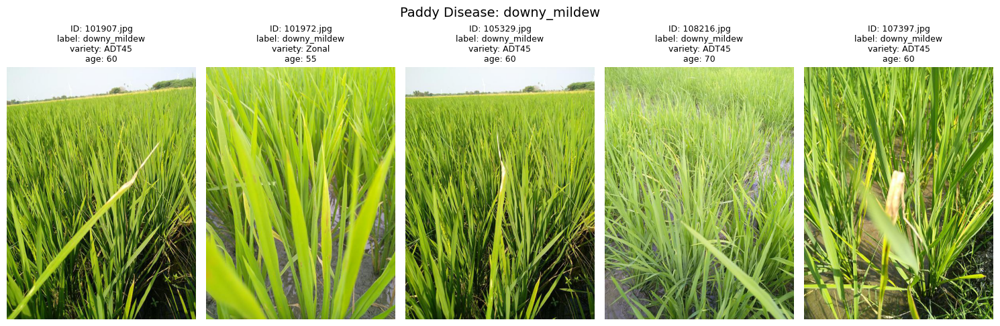

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `HISPA`           |
			+----------------------------------------------------+


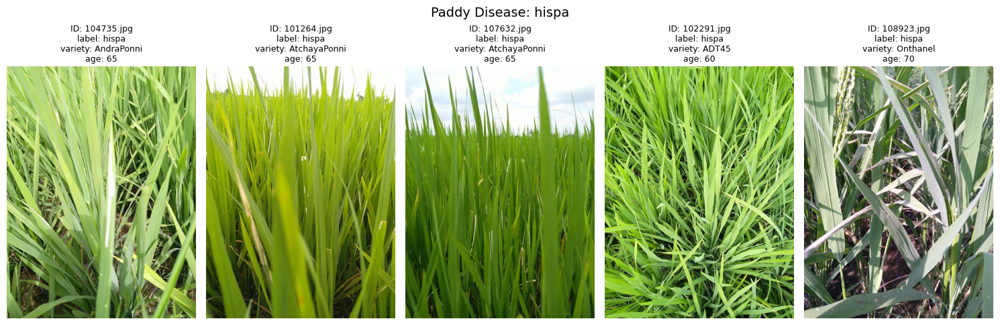

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `NORMAL`           |
			+-----------------------------------------------------+


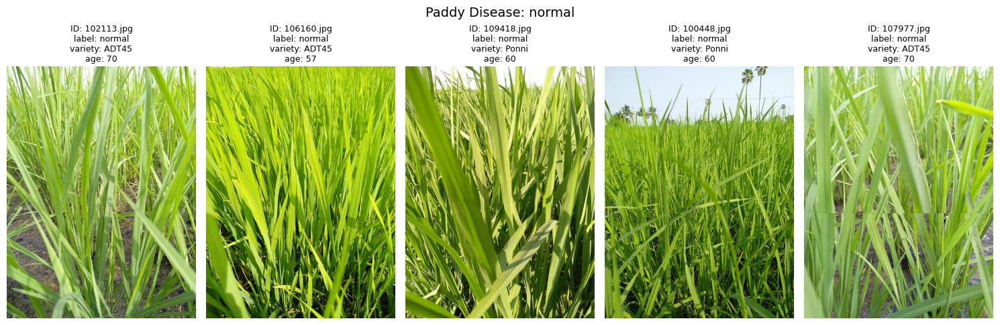

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `TUNGRO`           |
			+-----------------------------------------------------+


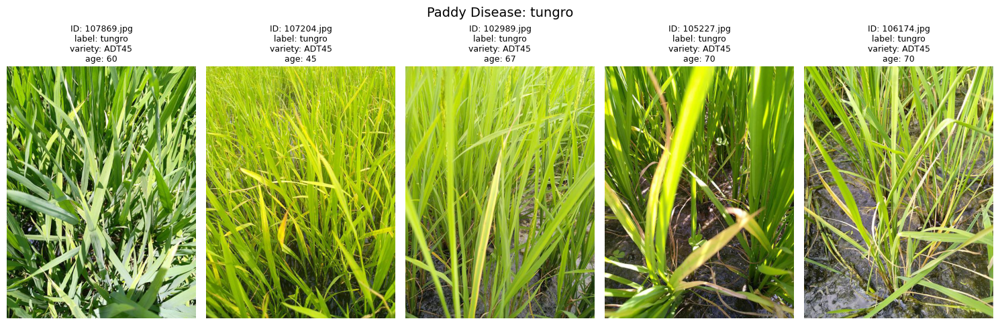

In [23]:
# List of directories for each label
labels = [
    "bacterial_leaf_blight",
    "bacterial_leaf_streak",
    "bacterial_panicle_blight",
    "blast",
    "brown_spot",
    "dead_heart",
    "downy_mildew",
    "hispa",
    "normal",
    "tungro",
]

# Base path for the image directories
base_path = "./inputs/train_images"

# Loop through each label directory and display images
for label in labels:
    # Filter dataframe for the current label
    label_df = df[df["label"] == label].sample(5, random_state=42)

    directory = os.path.join(base_path, label)
    print_header(f"Visualizing Images for `{label}`", tabs=True)

    # Display images
    visualize_images(
        label_df,
        num_images=len(label_df),
        title=f"Paddy Disease: {label}",
        figsize=(15, 5),
    )

### 4.2) Variety Image Visualization

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ADT45`           |
			+----------------------------------------------------+


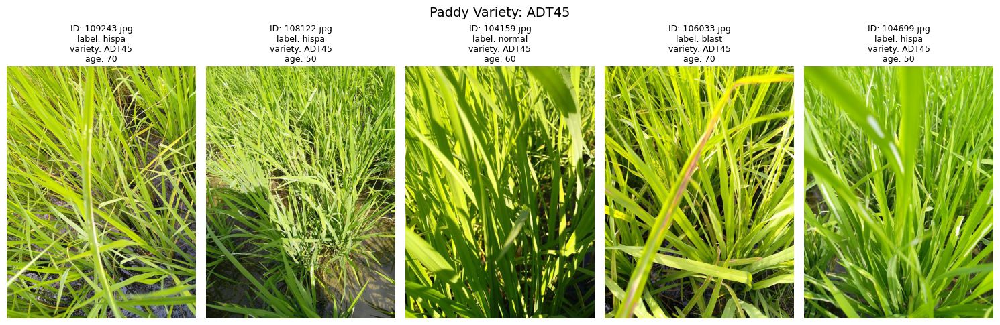

			+---------------------------------------------------+
			|           VISUALIZING IMAGES FOR `IR20`           |
			+---------------------------------------------------+


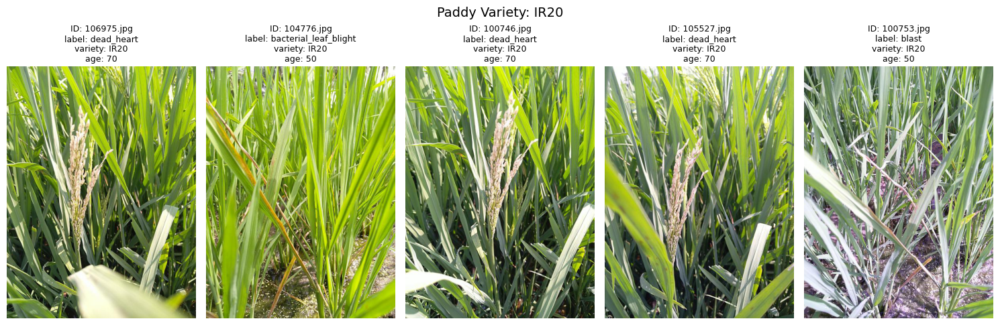

			+-------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `KARNATAKAPONNI`           |
			+-------------------------------------------------------------+


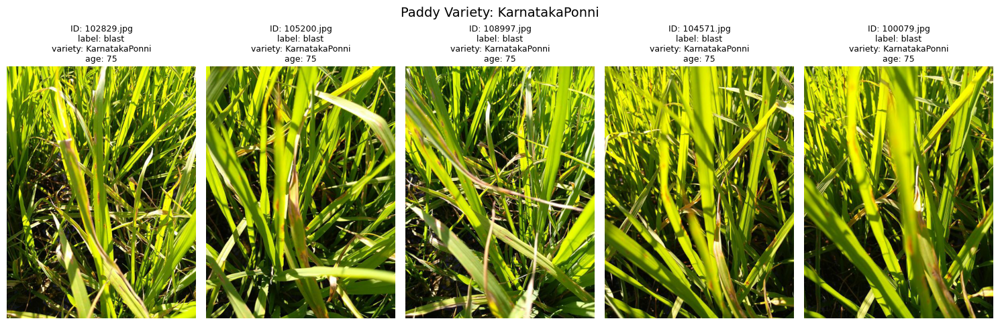

			+-------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ONTHANEL`           |
			+-------------------------------------------------------+


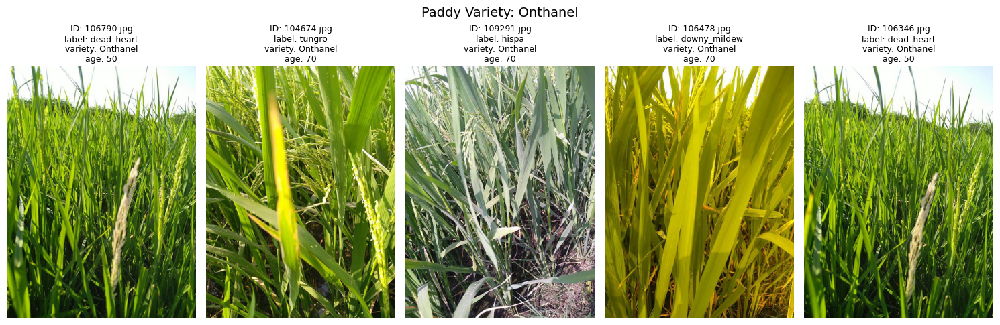

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `PONNI`           |
			+----------------------------------------------------+


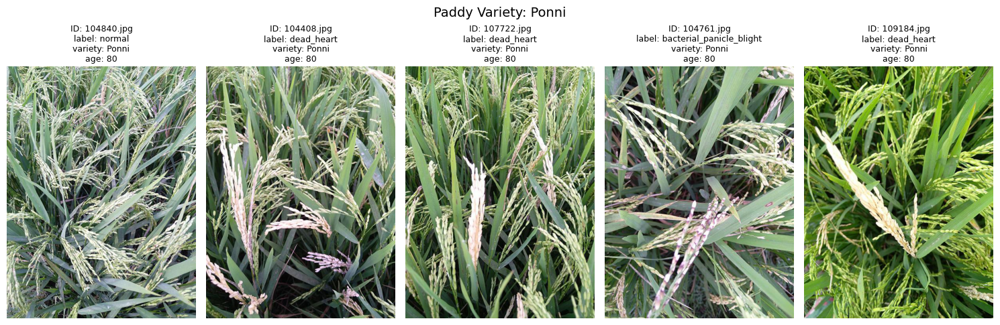

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `SURYA`           |
			+----------------------------------------------------+


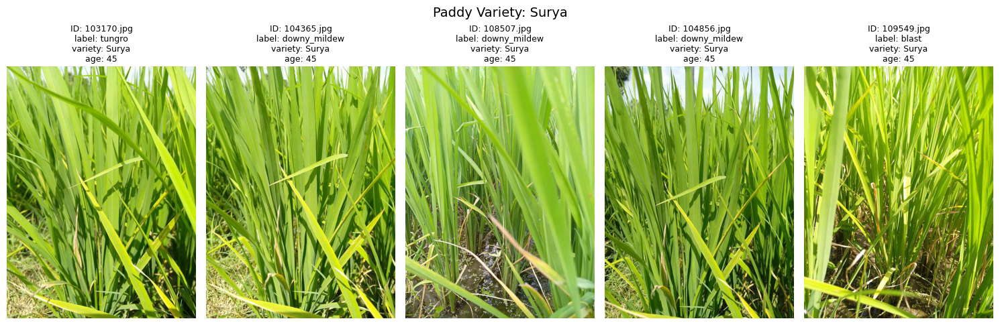

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ZONAL`           |
			+----------------------------------------------------+


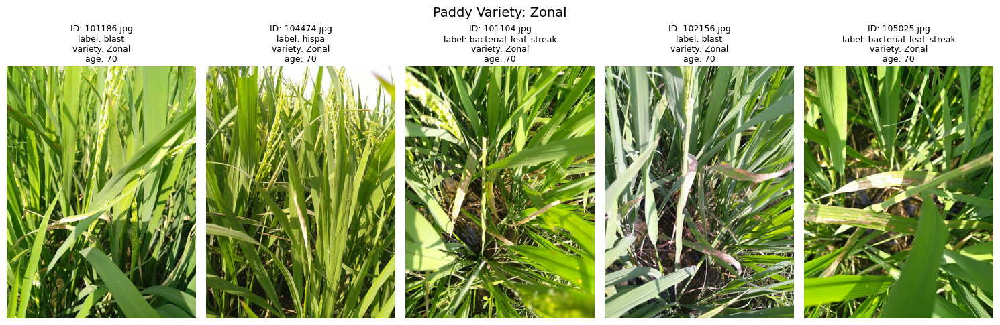

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ANDRAPONNI`           |
			+---------------------------------------------------------+


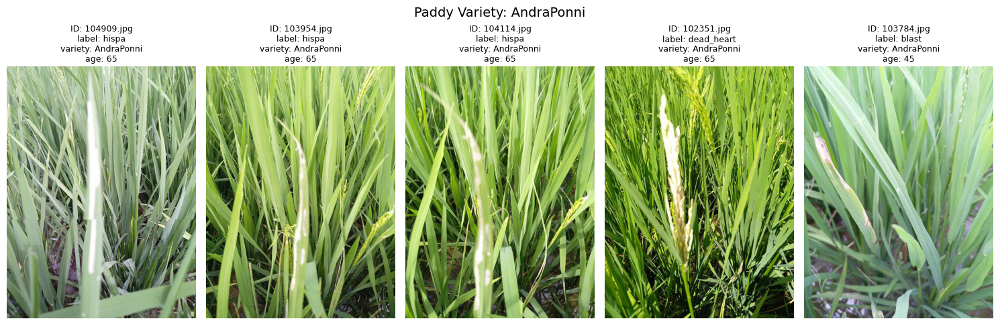

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ATCHAYAPONNI`           |
			+-----------------------------------------------------------+


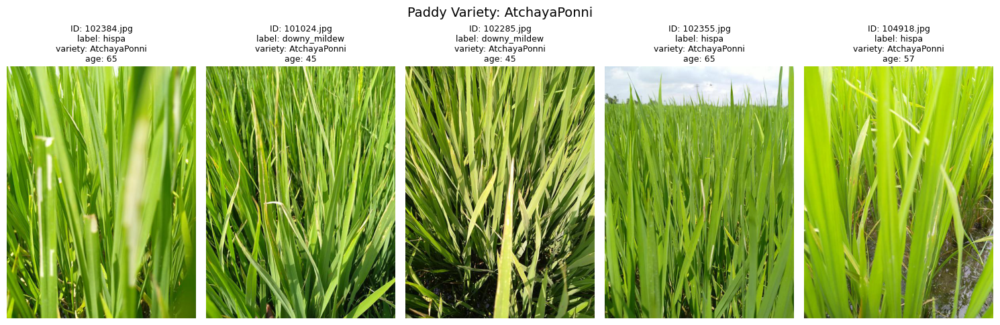

			+-------------------------------------------------+
			|           VISUALIZING IMAGES FOR `RR`           |
			+-------------------------------------------------+


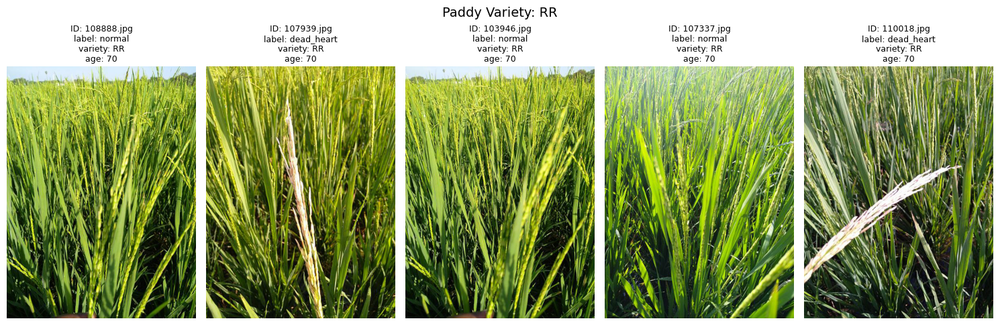

In [17]:
# List of paddy varieties
varieties = df["variety"].unique().tolist()

for variety in varieties:
    variety_df = df[df["variety"] == variety].sample(5, random_state=42)

    print_header(f"Visualizing Images for `{variety}`", tabs=True)

    visualize_images(
        variety_df,
        num_images=len(variety_df),
        title=f"Paddy Variety: {variety}",
        figsize=(15, 5),
    )

## 5) Data Distribution 

### 5.1) Plot label distribution

The label distribution of the paddy disease introduces a moderately imbalanced dataset with some classes significantly more represented than others:

- `normal` is most represented, which occupied approximately 17.0% of the samples.

- `blast` (16.7%), `hispa` (15.3%), and `dead_heart`(13.9%) are the three most popular diseases in the captured paddy.

- Conversely, `bacterial_panicle_bight` (3.2%) and `bacterial_leaf_steak` (3.7%) are the least common, indicating a potential challenge for further models to learn from these minority classes.

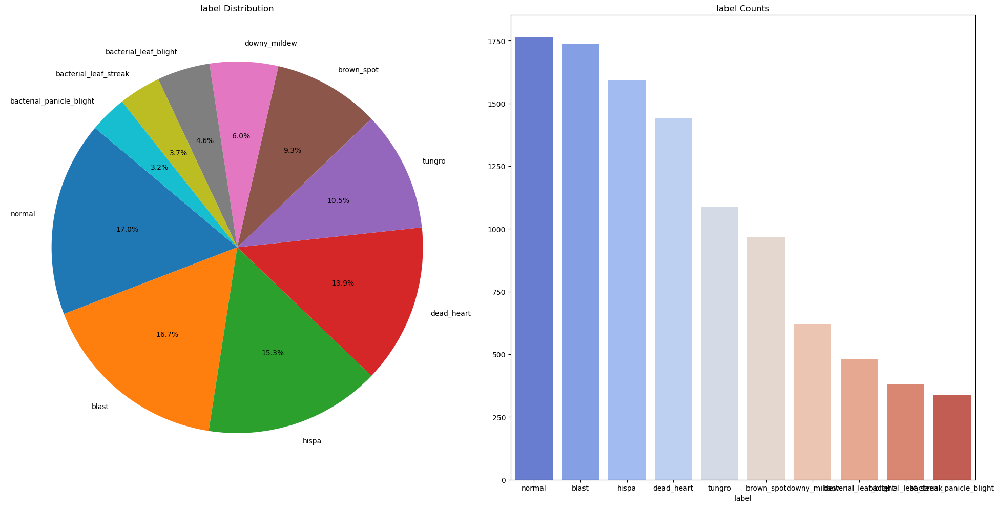

In [25]:
visualize_category_distribution(df, 'label')

### 5.2) Plot Variety Distribution

The **variety distribution** shows the **highly** imbalanced, where `ADT45` is the dominant variety, accounting for more than half of the dataset at 67.2%. By contrast, `Surya` and `RR` occupied less than 1%. 

This significant dominance of a single variety (`ADT45`) is a huge challenge for model training, where the model will be biased toward this variety if there's no balancing technique applied.

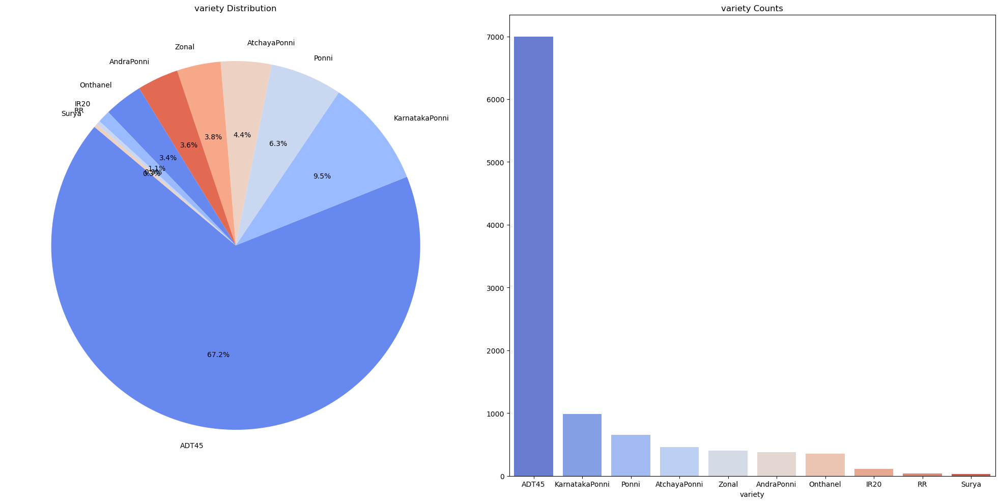

In [26]:
visualize_category_distribution(df, "variety")

### 5.3) Plot Age Distribution



The data distribution in the `age` column is slightly imbalanced:
- The most common age is `70` days which accounts for **29.6%** of the dataset. `70` days is the average age of paddy plants in the reproductive phase, which is the most common growth stage for rice plants.
- The second most common age is `60` days which accounts for **16%**
- The third most common age is `50` days which accounts for **10.2%**
- The least common age is `62` days and `82` days accounting for less than **0.5%**

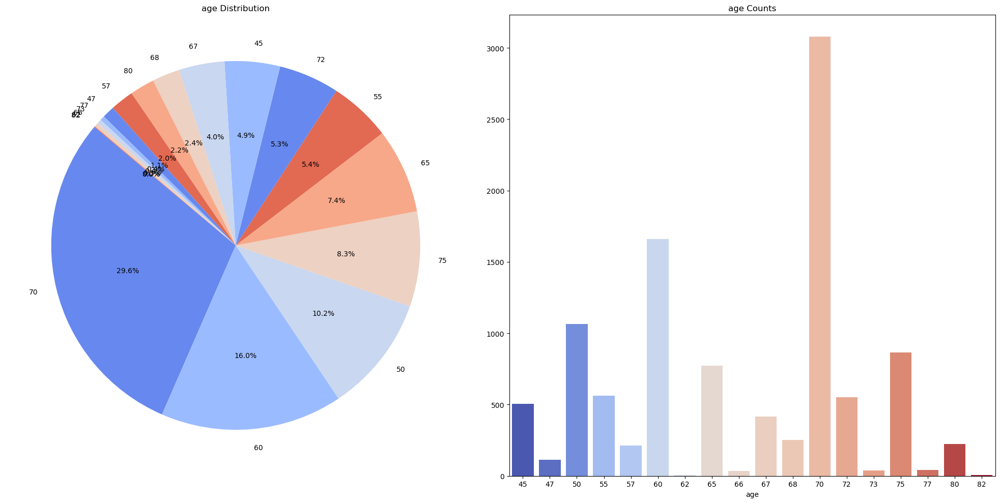

In [27]:
visualize_category_distribution(df, 'age')

The age of each variety is quite approximately the same, with the exception of `Surya` which are younger than the other.
- `RR` is the variety with the biggest average age(around 70 days)
- `KarnatakaPonni` is the second biggest average age(around 69 days)
- `Zonal` is the third biggest average age(around 65 days)
- `Surya` is the variety with the smallest average age(around 45 days)

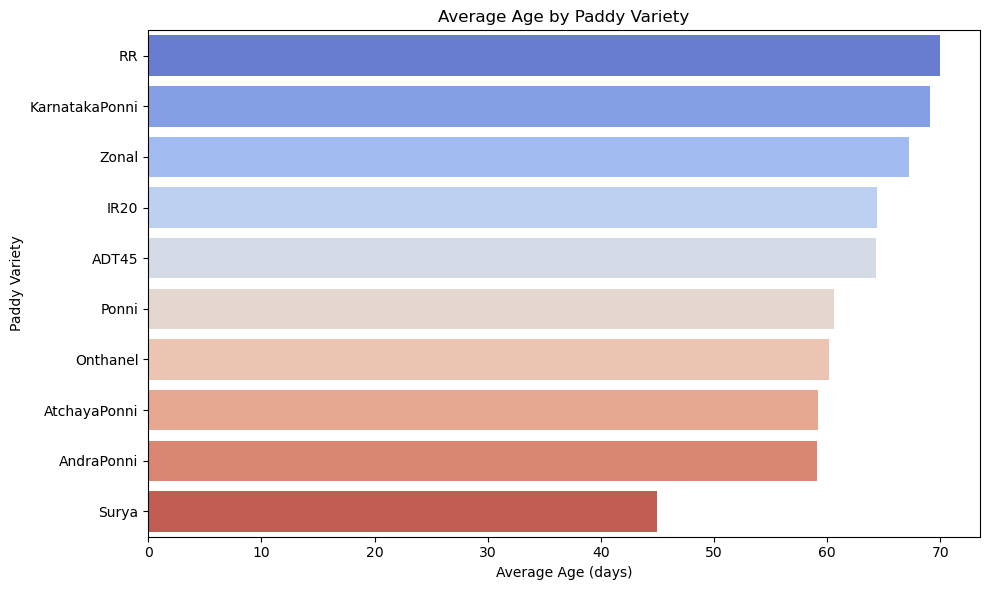

In [28]:
plot_grouped_bar(
    df,
    group_col="variety",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Variety",
    x_label="Average Age (days)",
    y_label="Paddy Variety",
)

The heatmap below clearly demonstrates that
- Only the **domain variety** (`ADT45`) across various age days.
- Other varieties, it is **highly Concentrated Age Clusters**: Each variety appears almost at 1 to 3 specific ages. For example:
  - `AndraPonni`: only data for 45 and 65.
  - `IR20`: Only 32 and 82 days.
  - `Onthanel`: ages 50 and 70.
  - ...

This pattern suggests that different varieties appear to be documented at specific growth phases rather than across their entire lives (except the `ADT45` variety). 
  - **Vegetative Phase (0 to 65 days)**: `Surya` (exclusively at 45 days), `AndraPonni`, `AtchayaPonni`, `Ponni`, and `Onthanel`.
  - **Reproductive Phase (65 to 100 days)**: `RR`, `AndraPonni`, `KarnatakaPonni`, `Zonal`.

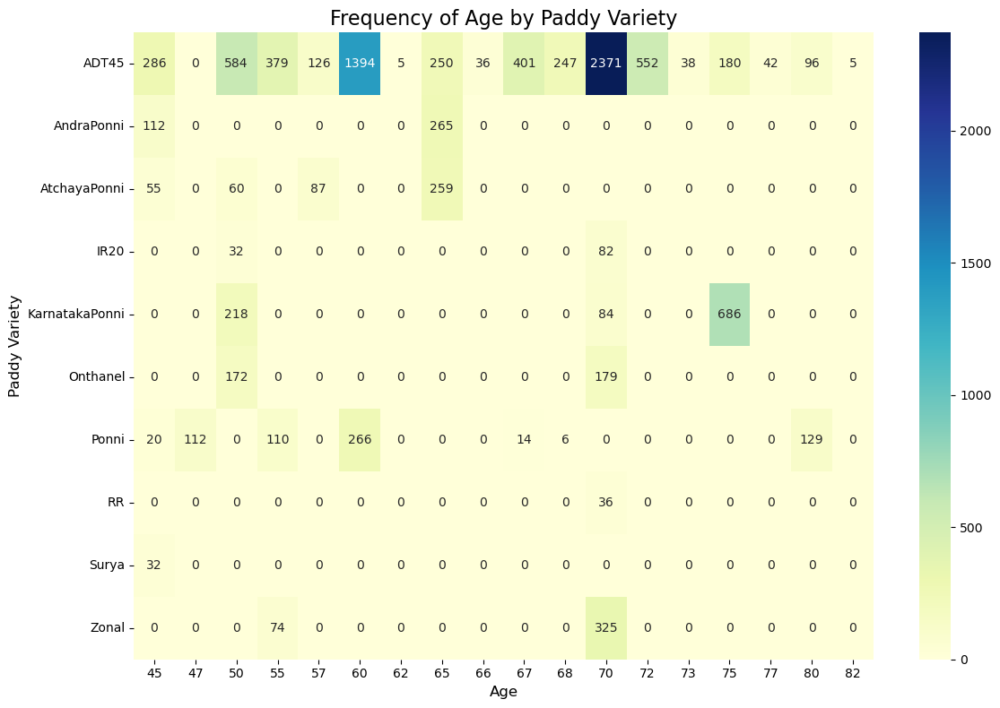

In [18]:
variety_label_counts = df.groupby(["variety", "age"]).size().unstack(fill_value=0)

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(variety_label_counts, annot=True, fmt="d", cmap="YlGnBu", cbar=True)

# Add titles and labels
plt.title("Frequency of Age by Paddy Variety", fontsize=16)
plt.xlabel("Age", fontsize=12)
plt.ylabel("Paddy Variety", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

Gennerally, the majority of diseases appear in the range 60-70 days, which is the reproductive phase of paddy plants.
- `bacterial_leaf_blight` is the disease that appears latest which is around 70 days
- `dead_heart` and `brown_spot` are the diseases that appear second amd third latest which are 68 and 64 days respectively
- `downy_mildew` is the disease that appears earliest which is around 60 days

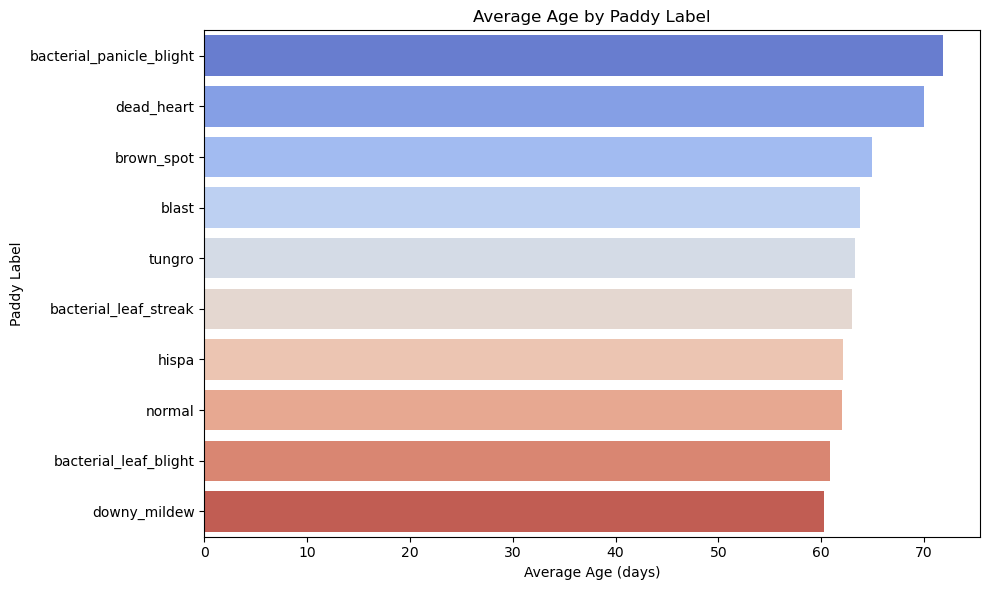

In [30]:
plot_grouped_bar(
    df,
    group_col="label",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Label",
    x_label="Average Age (days)",
    y_label="Paddy Label",
)

### 5.4) Variety vs Label

Disease occurrence varies strongly by variety
- `ADT45` dominates the dataset with all types of labels, especially `normal`, `dead_heart`, `tungro`.
- `KarnatakaPonni` falls mainly into `blast` disease
- Other variety have sparse records. For instance, `RR`, and `Surya` have almost no disease record

Specific diseases are concentrated in some specific varieties
- Diseases like `tungro` and `hispa` are significantly concentrated in `ADT45` variety.
- Varieties like `AndraPonni`, `AtchayaPonni`, and `Zonal` have very few diseases overall.


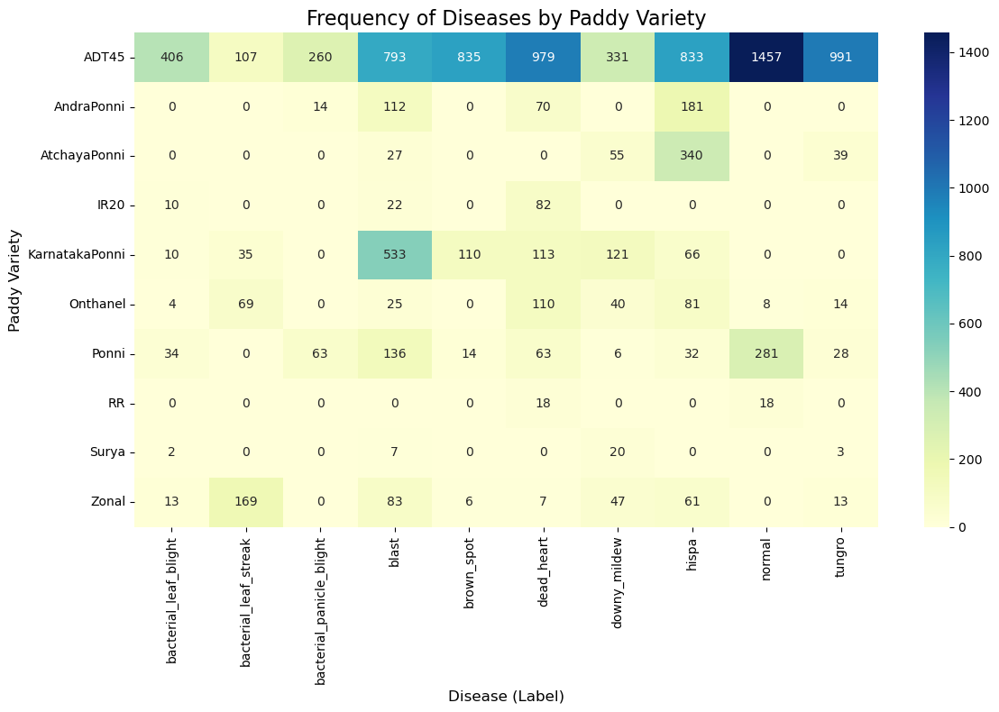

In [31]:
variety_label_counts = (
    df.groupby(["variety", "label"]).size().unstack(fill_value=0)
)

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(variety_label_counts, annot=True, fmt="d", cmap="YlGnBu", cbar=True)

# Add titles and labels
plt.title("Frequency of Diseases by Paddy Variety", fontsize=16)
plt.xlabel("Disease (Label)", fontsize=12)
plt.ylabel("Paddy Variety", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# IV. MODEL TRAINING

To ensure that the results are stable for multiple run time, we setup the seed for dataset

In [24]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

## 1) Helper Functions

In [25]:
def plot_learning_curve(train_loss, val_loss, train_metric, val_metric, metric_name='Accuracy'):

    plt.figure(figsize=(20,10))
    
    plt.subplot(1,2,1)
    plt.plot(train_loss, 'r--')
    plt.plot(val_loss, 'b--')
    plt.xlabel("epochs")
    plt.ylabel("Loss")
    plt.legend(['train', 'val'], loc='upper left')

    plt.subplot(1,2,2)
    plt.plot(train_metric, 'r--')
    plt.plot(val_metric, 'b--')
    plt.xlabel("epochs")
    plt.ylabel(metric_name)
    plt.legend(['train', 'val'], loc='upper left')

    plt.show()

## 2) Task 1: Disease Classification

### 2.1) Data Preprocessing

In [19]:
# Define random_state
random_state = 42

train_df, val_df = train_test_split(df, test_size=0.2, random_state=random_state)

print_header("Train Dataset shape")
print("Number of Rows: ", train_df.shape[0])
print("Number of Columns: ", train_df.shape[1])

print_header("Validation Dataset Shape")
print("Number of Rows: ", val_df.shape[0])
print("Number of Columns: ", val_df.shape[1])

+-----------------------------------------+
|           TRAIN DATASET SHAPE           |
+-----------------------------------------+
Number of Rows:  8325
Number of Columns:  5
+----------------------------------------------+
|           VALIDATION DATASET SHAPE           |
+----------------------------------------------+
Number of Rows:  2082
Number of Columns:  5


### 2.2) Setup global variables

`OUTPUT_CLASSES = 10`
This defines the number of output classes. Since the dataset contains 10 categories (9 disease types and 1 healthy class), the model must have 10 output units to predict the correct class for each image.

`BATCH_SIZE = 32`
The batch size is set to 32 as a common standard that balances model training efficiency and computational resources. It allows for reasonable updates while managing memory usage.

`INPUT_DIM = (64, 64, 3)`
The input dimension is 64x64 pixels with 3 color channels (RGB). This size is a standard choice, balancing computational cost with sufficient image detail for the task.



In [23]:
OUTPUT_CLASSES = 10
BATCH_SIZE = 32
INPUT_DIM = (128,128,3)

### 2.2) Store image in generator

The `ImageDataGenerator` is used to rescale pixel values to a [0, 1] range, which is a standard preprocessing step for neural networks. The `data_format='channels_last'` ensures the data is structured with color channels last, as required by many deep learning frameworks.

The `flow_from_dataframe` method is used because the image paths and labels are stored in a DataFrame. It makes it easy to load the images along with their labels directly from the DataFrame, allowing for efficient batch processing during training.

The images are resized to 64x64 pixels to standardize the input size for the model. This resolution is a common trade-off between detail and computational efficiency for image classification tasks.

The `class_mode='categorical'` is used because the task involves multi-class classification. This ensures the labels are one-hot encoded, suitable for a multi-class output.

The fixed `seed=42` is set to ensure reproducibility, making the data shuffling consistent across different runs of the model.

In [25]:
train_df["label"] = train_df["label"].astype("str")
val_df["label"] = val_df["label"].astype("str")

train_datagen = ImageDataGenerator(rescale=1.0 / 255, data_format="channels_last")
val_datagen = ImageDataGenerator(rescale=1.0 / 255, data_format="channels_last")

train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    directory="",
    x_col="image_path",
    y_col="label",
    target_size=(128, 128),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    seed=SEED,
)

val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_df,
    directory="",
    x_col="image_path",
    y_col="label",
    target_size=(128, 128),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    seed=SEED,
)

Found 8325 validated image filenames belonging to 10 classes.
Found 2082 validated image filenames belonging to 10 classes.
Found 2082 validated image filenames belonging to 10 classes.


### 2.3) Baseline Models

In this baseline models comparison, we set the average epochs for all models to be 25, this is to ensure the fairness between all models and for clearer visualizations. Moreover, we compiled all models with `Adam` optimizer and the loss function of `categorical_crossentropy`. 

- `Adaptive Learning Rates`: It helps to adapt the learning rate for each parameter in the model. This is highly beneficial as different parameters might require different update magnitudes to learn effectively. With combination of `categorical_crossentropy`, we can be more effective when it comes to dealing with complex, high-dimensional loss landscapes. 
- `Momentum Integration`: It incorporates past gradients, which helps to accelerate the optimization process in relavant direction and dampen oscillations.
- `Bias Correction`: Adam includes a bias correction for its initial zero-set estimates. This counteracts their tendency to be pulled towards zero early in training, leading to more stable updates from the outset.
- `Computing efficiency`: The optimizer also uses less memory and still provides a good results. Also, it also has a good default settinsg, therefore, with less configuration, we can still get a good results.
- `Effective with large dataset`: Adam works well for large-scale problems, whether that means lots of data or many model parameters. This makes it a good fit for common situations like training models that need to distinguish between multiple classes.

When paired with `categorical_crossentropy`, the Adam optimizer effectively leverages its aforementioned advantages to significantly boost the model's performance in multi-class classification tasks.
#### 2.3.1) MLP


The `MLP model` is a simple feedforward neural network with three hidden layers. The architecture is as follows:
- **Input Layer**: Accepts the input images, flattened to a 1D array.
- **Hidden Layer 1**: 1024 neurons with `ReLU activation`
- **Hidden Layer 2**: 512 neurons with `ReLU activation` 
- **Hidden Layer 3**: 256 neurons with `ReLU activation`
- **Output Layer**: 10 neurons with `softmax` activation for multi-class classification.

In [22]:
mlp_baseline = Sequential(
    [
        # Input layer and flatten
        Flatten(input_shape=INPUT_DIM),
        Dense(1024, activation="relu"),
        Dense(512, activation="relu"),
        Dense(256, activation="relu"),
        # Output layer (10 classes)
        Dense(10, activation="softmax"),
    ]
)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [81]:
mlp_baseline.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten_6 (Flatten)             │ (None, 12288)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 1024)           │    12,583,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 10)             │         2,570 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 13,242,634 (50.52 MB)

 Trainable params: 13,242,634 (50.52 MB)

 Non-trainable params: 0 (0.00 B)

Tại sao adam tại sao categorical crossentropy

In [82]:
# Compile model
mlp_baseline.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [83]:
mlp_history = mlp_baseline.fit(
    train_generator,
    validation_data=val_generator,
    epochs=25,
    verbose=1,
)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 29s 110ms/step - accuracy: 0.1836 - loss: 3.6300 - val_accuracy: 0.3007 - val_loss: 1.9949
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 108ms/step - accuracy: 0.3004 - loss: 1.9582 - val_accuracy: 0.3650 - val_loss: 1.8129
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 31s 119ms/step - accuracy: 0.3696 - loss: 1.7899 - val_accuracy: 0.3453 - val_loss: 1.8796
Epoch 4/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 108ms/step - accuracy: 0.4321 - loss: 1.6651 - val_accuracy: 0.4135 - val_loss: 1.7481
Epoch 5/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 29s 110ms/step - accuracy: 0.4689 - loss: 1.5486 - val_accuracy: 0.4822 - val_loss: 1.5406
Epoch 6/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 29s 109ms/step - accuracy: 0.5709 - loss: 1.2887 - val_accuracy: 0.4827 - val_loss: 1.5804
Epoch 7/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 107ms/step - accuracy: 0.5939 - loss: 1.1976 - val_accuracy: 0.5235 - val_loss: 1.4857
Epoch 8/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 108ms/step - accuracy: 0.6470 - loss: 1

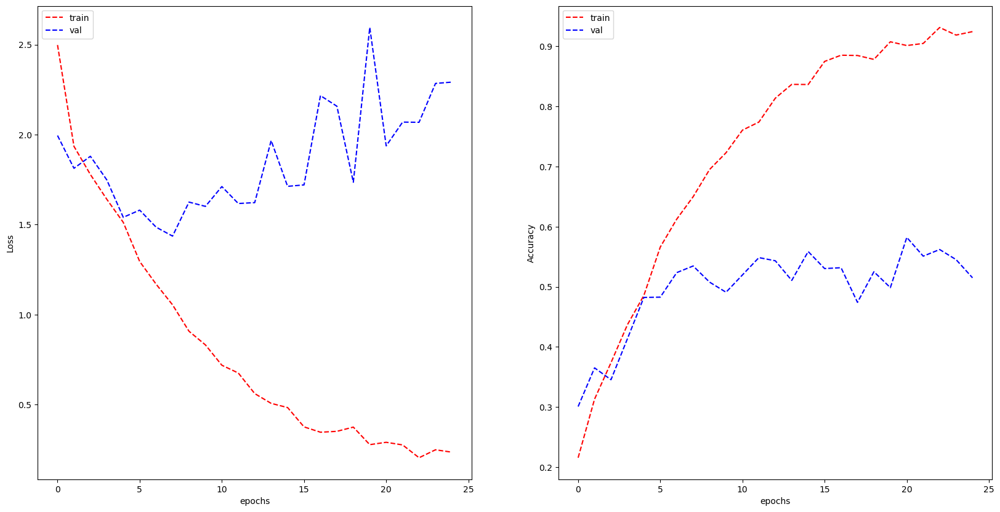

In [85]:
plot_learning_curve(
    mlp_history.history["loss"],
    mlp_history.history["val_loss"],
    mlp_history.history["accuracy"],
    mlp_history.history["val_accuracy"],
)

#### 2.3.2) CNN

CNNs are particularly effective for image classification, making them a strong choice for this project, which involves classifying paddy plant images into disease categories or a healthy class. The reasons for using CNNs include:

- **Automatic Feature Extraction**: CNNs learn relevant features from raw pixel data, eliminating the need for manual feature engineering, and making them ideal for complex image tasks like classifying plant diseases.
  
- **Spatial Awareness**: CNNs preserve the spatial structure of images, allowing them to detect important patterns such as disease symptoms in plant images.

- **Efficiency**: Through convolution and pooling layers, CNNs reduce the number of parameters, making the model computationally efficient while still capturing essential details from images.

- **Proven Performance**: CNNs have consistently outperformed other models in image classification tasks and are the standard approach for processing visual data.

In short, CNNs are the best choice for this task due to their ability to automatically extract features, process images efficiently, and deliver high performance for classification tasks.


In [24]:
cnn_baseline = Sequential(
    [
        Conv2D(16, (3, 3), activation="relu", input_shape=INPUT_DIM),
        MaxPooling2D(2, 2),
        Conv2D(32, (3, 3), activation="relu"),
        MaxPooling2D(2, 2),
        Conv2D(64, (3, 3), activation="relu"),
        MaxPooling2D(2, 2),
        Flatten(),
        Dense(1024, activation="relu"),
        Dense(128, activation="relu"),
        Dense(OUTPUT_CLASSES, activation="softmax"),
    ]
)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [90]:
cnn_baseline.summary()

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 62, 62, 16)     │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 31, 31, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 29, 29, 32)     │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 14, 14, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 12, 12, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 6, 6, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 2304)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 1024)           │     2,360,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 128)            │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,516,394 (9.60 MB)

 Trainable params: 2,516,394 (9.60 MB)

 Non-trainable params: 0 (0.00 B)

In [91]:
cnn_baseline.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [92]:
cnn_history = cnn_baseline.fit(
    train_generator,
    validation_data=val_generator,
    epochs=25,
    verbose=1,
)

Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 35s 131ms/step - accuracy: 0.2316 - loss: 2.0900 - val_accuracy: 0.4011 - val_loss: 1.7405
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 30s 113ms/step - accuracy: 0.4807 - loss: 1.5396 - val_accuracy: 0.5759 - val_loss: 1.2474
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 30s 116ms/step - accuracy: 0.6476 - loss: 1.0919 - val_accuracy: 0.6643 - val_loss: 1.0139
Epoch 4/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 30s 114ms/step - accuracy: 0.7639 - loss: 0.7406 - val_accuracy: 0.7358 - val_loss: 0.8522
Epoch 5/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 31s 118ms/step - accuracy: 0.8510 - loss: 0.4770 - val_accuracy: 0.7815 - val_loss: 0.7102
Epoch 6/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 106ms/step - accuracy: 0.9120 - loss: 0.2916 - val_accuracy: 0.8084 - val_loss: 0.6869
Epoch 7/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 106ms/step - accuracy: 0.9443 - loss: 0.1779 - val_accuracy: 0.8329 - val_loss: 0.6168
Epoch 8/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 28s 106ms/step - accuracy: 0.9609 - loss: 0

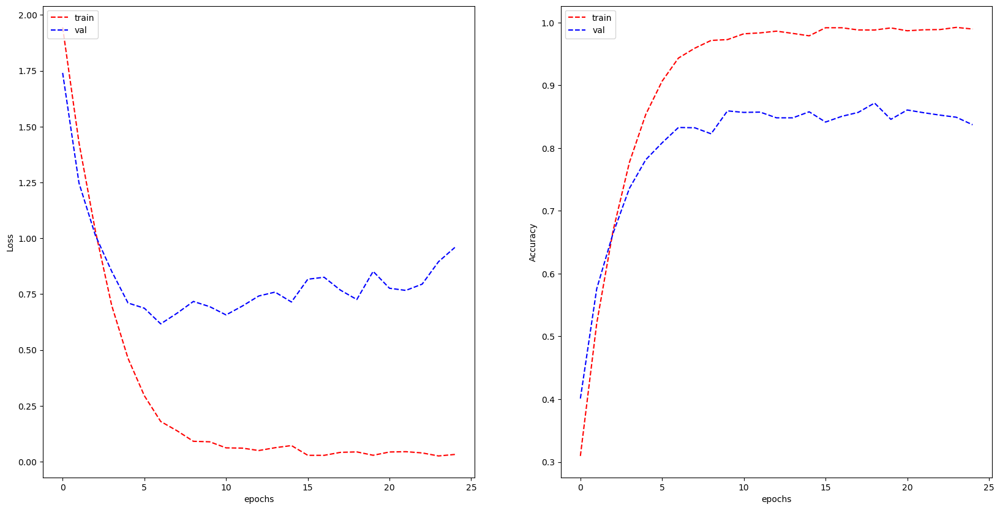

In [94]:
plot_learning_curve(
    cnn_history.history["loss"],
    cnn_history.history["val_loss"],
    cnn_history.history["accuracy"],
    cnn_history.history["val_accuracy"],
    metric_name="Accuracy",
)

#### 2.3.3) KNN and CNN + SVC Model

Trước khi train CNN và SVC Model thì phải qua bước extractor... xong rồi mơi train ở dưới


The model is a combination of a Convolutional Neural Network (CNN) and a K-Nearest Neighbors (KNN) classifier. The CNN is used for feature extraction, while the KNN classifier is used for the final classification.

In [23]:
# Function to extract features using the model
def extract_features(feature_extractor, generator):
    features = []
    labels = []
    for i in range(len(generator)):
        batch_images, batch_labels = generator[i]  # Get batch from generator
        batch_features = feature_extractor.predict(
            batch_images, verbose=0
        )  # Get features from CNN
        features.append(batch_features)
        labels.append(batch_labels)

        # If it's the last batch, break the loop
        if len(features) * generator.batch_size >= generator.samples:
            break

    # Convert to numpy arrays
    features = np.vstack(features)
    labels = np.vstack(labels)

    return features, labels

In [24]:
# Create the GlorotUniform initializer with a seed
initializer = GlorotUniform(seed=SEED)
# Define the feature extraction part
feature_extractor = Sequential(
    [
        Conv2D(
            16,
            (3, 3),
            activation="relu",
            input_shape=INPUT_DIM,
            kernel_initializer=initializer,
        ),
        MaxPooling2D(2, 2),
        Conv2D(32, (3, 3), activation="relu"),
        MaxPooling2D(2, 2),
        Conv2D(64, (3, 3), activation="relu"),
        MaxPooling2D(2, 2),
        Flatten(),
    ]
)

for layer in feature_extractor.layers:
    if hasattr(layer, "kernel_initializer"):
        layer.kernel.assign(layer.kernel_initializer(layer.kernel.shape))

# Compile the feature extractor
feature_extractor.compile(
    optimizer="adam", loss=None
)  # No loss needed for feature extraction

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [25]:
# Extract features and labels from the train and validation generators
train_features, train_labels = extract_features(feature_extractor, train_generator)
val_features, val_labels = extract_features(feature_extractor, val_generator)

# Flatten the labels to 1D (from one-hot encoding) for KNN
train_labels_flat = np.argmax(train_labels, axis=1)
val_labels_flat = np.argmax(val_labels, axis=1)

##### 2.3.3.1) KNN Model

In [133]:
# Train KNN classifier
knn_baseline = KNeighborsClassifier(n_neighbors=5)
knn_baseline.fit(train_features, train_labels_flat)

# Make predictions on the validation set
knn_train_pred = knn_baseline.predict(train_features)
# Make predictions on the validation set
knn_val_pred = knn_baseline.predict(val_features)


In [134]:
# Evaluate the model accuracy
knn_train_accuracy = accuracy_score(train_labels_flat, knn_train_pred)
print(f"Train accuracy of the CNN + KNN model: {knn_train_accuracy * 100:.2f}%")

# Evaluate the model accuracy
knn_val_accuracy = accuracy_score(val_labels_flat, knn_val_pred)
print(f"Validation accuracy of the CNN + KNN model: {knn_val_accuracy * 100:.2f}%")

Train accuracy of the CNN + KNN model: 87.14%
Validation accuracy of the CNN + KNN model: 76.61%


##### 2.3.1) CNN + SVC Models

The model is a combination of a Convolutional Neural Network (CNN) and a Support Vector Classifier (SVC). The CNN is used for feature extraction, while the SVC classifier is used for the final classification.

In [135]:
# Train an SVM classifier on the extracted features
svc_classifier = SVC(kernel="rbf", C=1.0, gamma="scale")
svc_classifier.fit(train_features, train_labels_flat)

# Make predictions on the test set
svc_val_pred = svc_classifier.predict(val_features)
svc_train_pred = svc_classifier.predict(train_features)

In [138]:
# Evaluate the SVM model
svc_train_accuracy = accuracy_score(train_labels_flat, svc_train_pred)
print(f"Train Accuracy of the CNN + SVM model: {svc_train_accuracy * 100:.2f}%")

svc_val_accuracy = accuracy_score(val_labels_flat, svc_val_pred)
print(f"Validation Accuracy of the CNN + SVM model: {svc_val_accuracy * 100:.2f}%")

Train Accuracy of the CNN + SVM model: 49.81%
Validation Accuracy of the CNN + SVM model: 46.83%


In [143]:
def plot_model_results(model_results, title="Model Comparison", figsize=(12, 8)):
    """
    Plots training and validation accuracies for multiple models side by side for easy comparison.

    Parameters:
    - model_results: Dictionary where keys are model names and values are tuples of (train_accuracy, val_accuracy)
    - title: Title for the plot
    - figsize: Figure size as (width, height)
    """
    # Create a DataFrame for easy plotting with seaborn
    data = []
    for model_name, (train_acc, val_acc) in model_results.items():
        data.append({"Model": model_name, "Accuracy": train_acc, "Type": "Training"})
        data.append({"Model": model_name, "Accuracy": val_acc, "Type": "Validation"})

    # Convert to DataFrame for seaborn
    plot_df = pd.DataFrame(data)

    # Set up the figure
    plt.figure(figsize=figsize)

    # Create the grouped bar chart
    ax = sns.barplot(
        x="Model", y="Accuracy", hue="Type", data=plot_df, palette='coolwarm'
    )

    # Add value labels on top of each bar
    for container in ax.containers:
        ax.bar_label(container, fmt="%.4f", padding=3)

    # Customize the plot
    plt.title(title, fontsize=16)
    plt.ylabel("Accuracy", fontsize=12)
    plt.ylim(0, 1.05)  # Leave room for value labels
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.legend(title="", loc="upper right")
    plt.xticks(rotation=45 if len(model_results) > 3 else 0)

    # Adjust layout
    plt.tight_layout()
    plt.show()

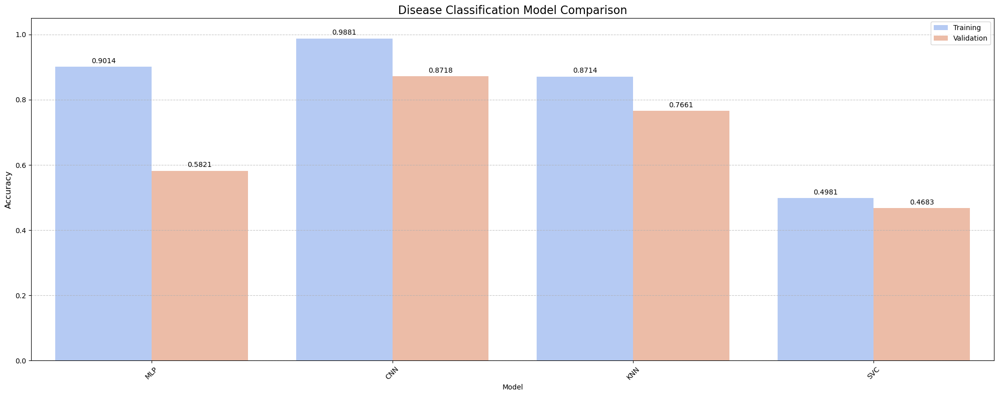

In [166]:
# Get MLP accuracies
best_mlp_epoch = np.argmax(mlp_history.history["val_accuracy"])
mlp_val_accuracy = mlp_history.history["val_accuracy"][best_mlp_epoch]
mlp_train_accuracy = mlp_history.history["accuracy"][best_mlp_epoch]

# Get CNN accuracies
best_cnn_epoch = np.argmax(cnn_history.history["val_accuracy"])
cnn_val_accuracy = cnn_history.history["val_accuracy"][best_cnn_epoch]
cnn_train_accuracy = cnn_history.history["accuracy"][best_cnn_epoch]

model_results = {
    "MLP": (mlp_train_accuracy, mlp_val_accuracy),
    "CNN": (cnn_train_accuracy, cnn_val_accuracy),
    "KNN": (knn_train_accuracy, knn_val_accuracy),
    "SVC": (svc_train_accuracy, svc_val_accuracy),
}

plot_model_results(
    model_results, "Disease Classification Model Comparison", figsize=(20, 8)
)

**Oberservation**: The CNN is the best model. Although the CNN is best model with high accuracy on the training set, its accuracy on the validation set is not good as on the training set. For that reason, this model is overfitting. We need to apply some techniques to reduce overfitting.

### 2.4) Model Selection and Tuning

From the results of the baseline models, we can see that the CNN model is the best model with high accuracy on the training set. However, its accuracy on the validation set is not good as on the training set. For that reason, this model is overfitting. We need to apply some techniques to ehnace the model performance and reduce overfitting.
- Adding blocks (VGG block)
- Adding dropout layers
- Applying Early Stopping

In [32]:
def build_vgg_model(l2_strength):
    return Sequential(
        [
           # Block 1 - L2 Regularizer REMOVED from this block for demonstration
            Conv2D(
                64,
                (3, 3),
                activation="relu",
                padding="same",
                input_shape=INPUT_DIM,
                # kernel_regularizer=active_reg, # <-- Regularizer removed
            ),
            Conv2D(
                64,
                (3, 3),
                activation="relu",
                padding="same",
                # kernel_regularizer=active_reg, # <-- Regularizer removed
            ),
            MaxPooling2D((2, 2)),

            # Block 2 - L2 Regularizer KEPT for this block
            Conv2D(
                128,
                (3, 3),
                activation="relu",
                padding="same",
                kernel_regularizer=l2_strength, # Kept
            ),
            Conv2D(
                128,
                (3, 3),
                activation="relu",
                padding="same",
                kernel_regularizer=l2_strength, # Kept
            ),
            MaxPooling2D((2, 2)),

            # Block 3 - L2 Regularizer KEPT for this block
            Conv2D(
                256,
                (3, 3),
                activation="relu",
                padding="same",
                kernel_regularizer=l2_strength, # Kept
            ),
            MaxPooling2D((2, 2)),
            Flatten(),

            # Dense Layers
            Dense(256, activation="relu",
                  # kernel_regularizer=active_reg  # <-- Regularizer REMOVED from this Dense layer
                 ),
            Dropout(0.5),
            Dense(128, activation="relu",
                  kernel_regularizer=l2_strength  # <-- Regularizer KEPT for this Dense layer
                 ),
            Dropout(0.5),
            Dense(OUTPUT_CLASSES, activation="softmax"),
        ]
    )

In [ ]:
# Initialize tracking variables
lambda_parameters = [0.0001, 0.001, 0.01, 0.1]
best_model_found = None
best_val_accuracy = 0
best_lambda = None
best_model_path = None

for para_l2_strength in lambda_parameters:
    print(f"\nTraining model with L2 regularization lambda = {para_l2_strength}")

    from tensorflow.keras.regularizers import l2
    
    vgg_model = build_vgg_model(l2(para_l2_strength))
    vgg_model.compile(
        optimizer=Adam(learning_rate=0.0001), loss="categorical_crossentropy", metrics=["accuracy"]
    )

    early_stopping = EarlyStopping(
        monitor="val_accuracy", patience=15, restore_best_weights=True
    )

    history = vgg_model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=25,
        callbacks=[early_stopping],
        verbose=1,
    )

    current_val_accuracy = max(history.history["val_accuracy"])

    if current_val_accuracy > best_val_accuracy:
        best_val_accuracy = current_val_accuracy
        best_lambda = para_l2_strength
        best_model_found =  vgg_model
        best_model_path = f"./models/vgg_best_model_lambda_{best_lambda}.h5"

        print(
            f"*** New best model found with lambda={para_l2_strength}, val_accuracy: {current_val_accuracy:.4f} ***\n"
        )

        best_model_found.save(best_model_path)
    else:
        print(
            f"Model with lambda={para_l2_strength} (val_acc: {current_val_accuracy:.4f}) did not improve over current best (val_acc: {best_val_accuracy:.4f})\n"
        )

print(f"Best lambda: {best_lambda}, saved at {best_model_path}")


Training model with L2 regularization lambda = 0.0001


/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 490s 2s/step - accuracy: 0.1671 - loss: 2.2685 - val_accuracy: 0.3165 - val_loss: 2.0581
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 471s 2s/step - accuracy: 0.2815 - loss: 2.0873 - val_accuracy: 0.4145 - val_loss: 1.8269
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 476s 2s/step - accuracy: 0.3713 - loss: 1.8812 - val_accuracy: 0.4534 - val_loss: 1.6043
Epoch 4/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 484s 2s/step - accuracy: 0.4285 - loss: 1.6991 - val_accuracy: 0.5552 - val_loss: 1.4226
Epoch 5/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 499s 2s/step - accuracy: 0.5033 - loss: 1.4974 - val_accuracy: 0.6239 - val_loss: 1.2469
Epoch 6/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 496s 2s/step - accuracy: 0.5817 - loss: 1.2980 - val_accuracy: 0.6724 - val_loss: 1.1153
Epoch 7/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 483s 2s/step - accuracy: 0.6327 - loss: 1.1346 - val_accuracy: 0.7358 - val_loss: 0.9122
Epoch 8/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 490s 2s/step - accuracy: 0.6997 - loss: 0.9335 - val_accu

*** New best model found with lambda=0.0001, val_accuracy: 0.8871 ***


Training model with L2 regularization lambda = 0.001
Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 505s 2s/step - accuracy: 0.1686 - loss: 2.6939 - val_accuracy: 0.3381 - val_loss: 2.3326
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 514s 2s/step - accuracy: 0.2719 - loss: 2.3531 - val_accuracy: 0.3525 - val_loss: 2.0375
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 479s 2s/step - accuracy: 0.3471 - loss: 2.0913 - val_accuracy: 0.4558 - val_loss: 1.8226
Epoch 4/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 473s 2s/step - accuracy: 0.4115 - loss: 1.9143 - val_accuracy: 0.5207 - val_loss: 1.6366
Epoch 5/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 498s 2s/step - accuracy: 0.4657 - loss: 1.7077 - val_accuracy: 0.5812 - val_loss: 1.4467
Epoch 6/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 488s 2s/step - accuracy: 0.5305 - loss: 1.5482 - val_accuracy: 0.6671 - val_loss: 1.2781
Epoch 7/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 464s 2s/step - accuracy: 0.5968 - loss: 1.3607 - val_accuracy

In [22]:
print_header("Training Results")
print(f"Best L2 regularization lambda: {best_lambda}")
print(f"Best validation accuracy: {best_val_accuracy:.4f}")

+--------------------------------------+
|           TRAINING RESULTS           |
+--------------------------------------+
Best L2 regularization lambda: 0.0001
Best validation accuracy: 0.8871


In [ ]:
best_vgg_model = build_vgg_model(l2(0.0001))
best_vgg_model.compile(
        optimizer=Adam(learning_rate=0.0001), loss="categorical_crossentropy", metrics=["accuracy"]
    )
early_stopping = EarlyStopping(
        monitor="val_accuracy", patience=15, restore_best_weights=True
)
model_checkpoint = ModelCheckpoint(
    "./models/best_vgg_model.h5", monitor="val_loss", save_best_only=True, verbose=1
)
callbacks = [early_stopping, model_checkpoint]
history_vgg = best_vgg_model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=25,
        callbacks=[callbacks],
        verbose=1,
)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.1553 - loss: 2.2862
Epoch 1: val_loss improved from inf to 2.04754, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 434s 2s/step - accuracy: 0.1555 - loss: 2.2860 - val_accuracy: 0.3295 - val_loss: 2.0475
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.2802 - loss: 2.0730
Epoch 2: val_loss improved from 2.04754 to 1.83665, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 415s 2s/step - accuracy: 0.2803 - loss: 2.0728 - val_accuracy: 0.3727 - val_loss: 1.8367
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.3583 - loss: 1.8846
Epoch 3: val_loss improved from 1.83665 to 1.58728, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 433s 2s/step - accuracy: 0.3584 - loss: 1.8844 - val_accuracy: 0.4472 - val_loss: 1.5873
Epoch 4/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.4248 - loss: 1.7051
Epoch 4: val_loss improved from 1.58728 to 1.43863, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 431s 2s/step - accuracy: 0.4248 - loss: 1.7050 - val_accuracy: 0.5255 - val_loss: 1.4386
Epoch 5/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.4865 - loss: 1.5144
Epoch 5: val_loss improved from 1.43863 to 1.26589, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 431s 2s/step - accuracy: 0.4865 - loss: 1.5144 - val_accuracy: 0.5908 - val_loss: 1.2659
Epoch 6/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.5548 - loss: 1.3538
Epoch 6: val_loss improved from 1.26589 to 1.13987, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 433s 2s/step - accuracy: 0.5548 - loss: 1.3537 - val_accuracy: 0.6700 - val_loss: 1.1399
Epoch 7/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.6109 - loss: 1.2073
Epoch 7: val_loss improved from 1.13987 to 0.97332, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 421s 2s/step - accuracy: 0.6110 - loss: 1.2073 - val_accuracy: 0.7195 - val_loss: 0.9733
Epoch 8/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.6643 - loss: 1.0449
Epoch 8: val_loss improved from 0.97332 to 0.87272, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 433s 2s/step - accuracy: 0.6644 - loss: 1.0448 - val_accuracy: 0.7435 - val_loss: 0.8727
Epoch 9/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7088 - loss: 0.8999
Epoch 9: val_loss improved from 0.87272 to 0.82092, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 445s 2s/step - accuracy: 0.7088 - loss: 0.8999 - val_accuracy: 0.7776 - val_loss: 0.8209
Epoch 10/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7553 - loss: 0.7878
Epoch 10: val_loss improved from 0.82092 to 0.77954, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 438s 2s/step - accuracy: 0.7553 - loss: 0.7878 - val_accuracy: 0.7743 - val_loss: 0.7795
Epoch 11/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7772 - loss: 0.6873
Epoch 11: val_loss improved from 0.77954 to 0.66512, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 437s 2s/step - accuracy: 0.7772 - loss: 0.6872 - val_accuracy: 0.8156 - val_loss: 0.6651
Epoch 12/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8180 - loss: 0.5801
Epoch 12: val_loss did not improve from 0.66512
261/261 ━━━━━━━━━━━━━━━━━━━━ 430s 2s/step - accuracy: 0.8180 - loss: 0.5802 - val_accuracy: 0.8271 - val_loss: 0.6712
Epoch 13/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8267 - loss: 0.5524
Epoch 13: val_loss improved from 0.66512 to 0.65215, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 430s 2s/step - accuracy: 0.8267 - loss: 0.5523 - val_accuracy: 0.8160 - val_loss: 0.6522
Epoch 14/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8491 - loss: 0.4812
Epoch 14: val_loss improved from 0.65215 to 0.61202, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 433s 2s/step - accuracy: 0.8492 - loss: 0.4811 - val_accuracy: 0.8468 - val_loss: 0.6120
Epoch 15/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8733 - loss: 0.4188
Epoch 15: val_loss improved from 0.61202 to 0.58061, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 416s 2s/step - accuracy: 0.8733 - loss: 0.4189 - val_accuracy: 0.8573 - val_loss: 0.5806
Epoch 16/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8778 - loss: 0.4023
Epoch 16: val_loss improved from 0.58061 to 0.53843, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 400s 2s/step - accuracy: 0.8778 - loss: 0.4022 - val_accuracy: 0.8684 - val_loss: 0.5384
Epoch 17/25
Epoch 17/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8954 - loss: 0.3554
Epoch 17: val_loss did not improve from 0.53843
261/261 ━━━━━━━━━━━━━━━━━━━━ 435s 2s/step - accuracy: 0.8954 - loss: 0.3553 - val_accuracy: 0.8612 - val_loss: 0.5811
Epoch 18/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9085 - loss: 0.3069
Epoch 18: val_loss did not improve from 0.53843
261/261 ━━━━━━━━━━━━━━━━━━━━ 447s 2s/step - accuracy: 0.9085 - loss: 0.3069 - val_accuracy: 0.8655 - val_loss: 0.5469
Epoch 19/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9228 - loss: 0.2736
Epoch 19: val_loss did not improve from 0.53843
261/261 ━━━━━━━━━━━━━━━━━━━━ 428s 2s/step - accuracy: 0.9228 - loss: 0.2736 - val_accuracy: 0.8665 - val_loss: 0.5517
Epoch 20/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9305 - loss: 0.2623
Epoch 20: val_loss did not i

In [167]:
# vgg_model = models.Sequential(
#     [
#         # Block 1
#         layers.Conv2D(
#             32,
#             (3, 3),
#             activation="relu",
#             padding="same",
#             kernel_regularizer=l2(0.0001),
#             input_shape=INPUT_DIM,
#         ),
#         layers.Conv2D(
#             32,
#             (3, 3),
#             activation="relu",
#             padding="same",
#             kernel_regularizer=l2(0.0001),
#         ),
#         layers.MaxPooling2D((2, 2)),
#         # Block 2
#         layers.Conv2D(
#             64,
#             (3, 3),
#             activation="relu",
#             padding="same",
#             kernel_regularizer=l2(0.0001),
#         ),
#         layers.Conv2D(
#             64,
#             (3, 3),
#             activation="relu",
#             padding="same",
#             kernel_regularizer=l2(0.0001),
#         ),
#         layers.MaxPooling2D((2, 2)),
#         # Block 3
#         layers.Conv2D(
#             128,
#             (3, 3),
#             activation="relu",
#             padding="same",
#             kernel_regularizer=l2(0.0001),
#         ),
#         layers.MaxPooling2D((2, 2)),
#         # Fully connected layers
#         layers.Flatten(),
#         layers.Dense(256, activation="relu", kernel_regularizer=l2(0.0001)),
#         layers.Dropout(0.5),
#         layers.Dense(128, activation="relu", kernel_regularizer=l2(0.0001)),
#         layers.Dropout(0.5),
#         layers.Dense(OUTPUT_CLASSES, activation="softmax"),
#     ]
# )

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [35]:
best_vgg_model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_35 (Conv2D)              │ (None, 128, 128, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 128, 128, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 64, 64, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 65536)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 256)            │    16,777,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 52,100,960 (198.75 MB)

 Trainable params: 17,366,986 (66.25 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 34,733,974 (132.50 MB)

In [ ]:
# # # Compile the model
# best_vgg_model.compile(
#     optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"]
# )

In [ ]:
# early_stopping = EarlyStopping(
#     monitor="val_loss", patience=5, restore_best_weights=True, verbose=1
# )
# model_checkpoint = ModelCheckpoint(
#     "./models/best_vgg_model.h5", monitor="val_loss", save_best_only=True, verbose=1
# )
# callbacks = [early_stopping, model_checkpoint]
# history_VGG = best_model_found.fit(
#     train_generator,
#     validation_data=val_generator,
#     epochs=25,
#     verbose=1,
#     callbacks=callbacks,
# )

Epoch 1/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.6243 - loss: 1.3514
Epoch 1: val_loss improved from inf to 0.83153, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 529s 2s/step - accuracy: 0.6246 - loss: 1.3504 - val_accuracy: 0.7680 - val_loss: 0.8315
Epoch 2/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7891 - loss: 0.7103
Epoch 2: val_loss improved from 0.83153 to 0.81816, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 473s 2s/step - accuracy: 0.7891 - loss: 0.7103 - val_accuracy: 0.7685 - val_loss: 0.8182
Epoch 3/25
261/261 ━━━━━━━━━━━━━━━━━━━━ 0s 18s/step - accuracy: 0.8148 - loss: 0.6318 
Epoch 3: val_loss improved from 0.81816 to 0.63278, saving model to ./models/best_vgg_model.h5


261/261 ━━━━━━━━━━━━━━━━━━━━ 4664s 18s/step - accuracy: 0.8148 - loss: 0.6319 - val_accuracy: 0.8213 - val_loss: 0.6328
Epoch 4/25
 44/261 ━━━━━━━━━━━━━━━━━━━━ 5:21 1s/step - accuracy: 0.8514 - loss: 0.5038

KeyboardInterrupt: 

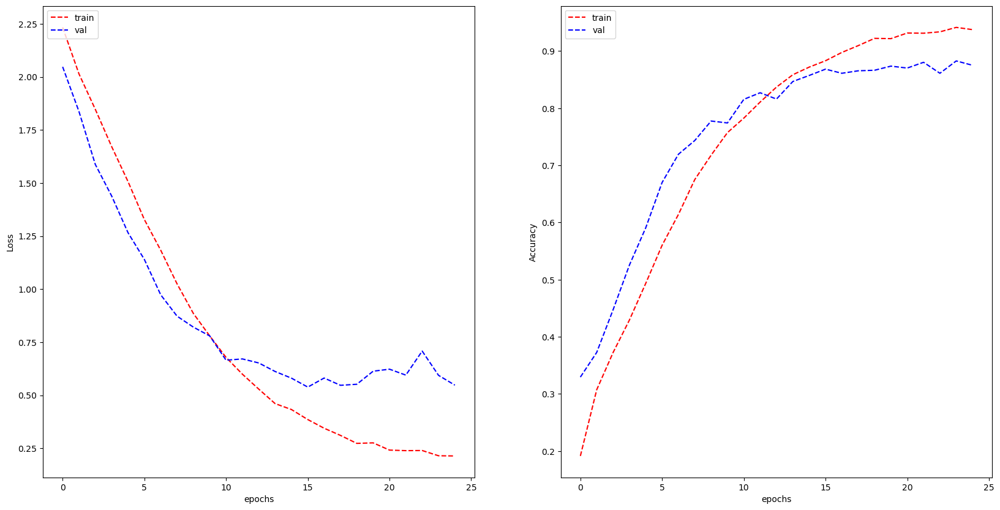

In [36]:
plot_learning_curve(
    history_vgg.history['loss'], history_vgg.history['val_loss'],
    history_vgg.history['accuracy'], history_vgg.history['val_accuracy'],
    metric_name='Accuracy'
)

In [2]:
model_path = "./models/best_vgg_model.h5"

In [3]:
try:
    loaded_best_model = load_model(model_path)
    print(f"Model loaded successfully from {model_path}")
except Exception as e:
    print(f"Error loading model: {e}")
    exit()

Model loaded successfully from ./models/best_vgg_model.h5


In [26]:
train_loss, train_accuracy = loaded_best_model.evaluate(train_generator, verbose=0)
print(f"Training Loss: {train_loss:.4f}")
print(f"Training Accuracy: {train_accuracy:.4f}")

val_loss, val_accuracy = loaded_best_model.evaluate(val_generator, verbose=0)
print(f"Validation Loss: {val_loss:.4f}")
print(f"Validation Accuracy: {val_accuracy:.4f}")

/opt/anaconda3/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Training Loss: 0.1058
Training Accuracy: 0.9868
Validation Loss: 0.5384
Validation Accuracy: 0.8684


In [27]:
# --- Predict on the Training Set ---
print("Predicting on the training set...")
raw_predictions_train = loaded_best_model.predict(train_generator, verbose=1)

# --- Predict on the Validation Set ---
print("\nPredicting on the validation set...")
raw_predictions_val = loaded_best_model.predict(val_generator, verbose=1)

Predicting on the training set...
261/261 ━━━━━━━━━━━━━━━━━━━━ 123s 470ms/step

Predicting on the validation set...
66/66 ━━━━━━━━━━━━━━━━━━━━ 30s 448ms/step


In [28]:
# --- (Optional but common) Get the predicted class indices ---
# This converts the raw probability outputs into the most likely class index.
predicted_class_indices_train = np.argmax(raw_predictions_train, axis=1)
predicted_class_indices_val = np.argmax(raw_predictions_val, axis=1)

In [29]:
print("\n--- Finished Predicting (Concise Version) ---")
print(f"Shape of raw_predictions_train: {raw_predictions_train.shape}")
print(f"Shape of predicted_class_indices_train: {predicted_class_indices_train.shape}")
print(f"Shape of raw_predictions_val: {raw_predictions_val.shape}")
print(f"Shape of predicted_class_indices_val: {predicted_class_indices_val.shape}")


--- Finished Predicting (Concise Version) ---
Shape of raw_predictions_train: (8325, 10)
Shape of predicted_class_indices_train: (8325,)
Shape of raw_predictions_val: (2082, 10)
Shape of predicted_class_indices_val: (2082,)


Input shape: (1, 128, 128, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Shape of raw_predictions: (1, 10)
Raw prediction output (scores for each class): [1.2294925e-04 1.5963653e-05 2.1331637e-07 2.3158743e-04 9.7986904e-04
 3.5896492e-06 2.7190617e-04 5.4186147e-01 4.5649418e-01 1.8249330e-05]
Predicted Class Index: 7
Confidence Score: 0.5419


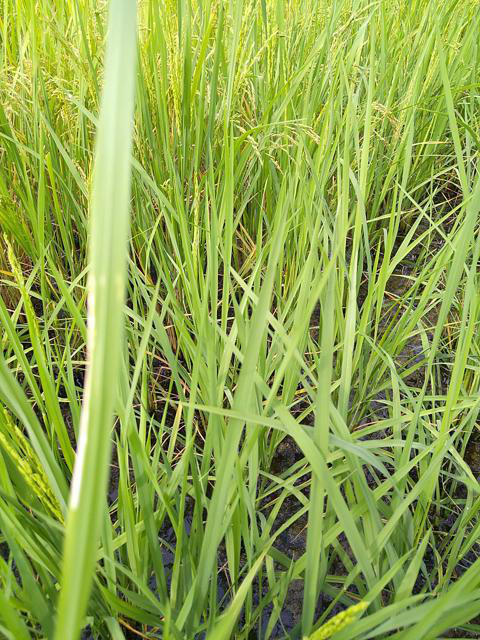

In [37]:
import numpy as np
from PIL import Image

# 1. Load the image
img_path = './inputs/test_images/200001.jpg'
img = Image.open(img_path)

# 2. Resize the image to match model's expected input
MODEL_INPUT_TARGET_SIZE = (128, 128)
img_resized = img.resize(MODEL_INPUT_TARGET_SIZE)

# 3. Convert image to numpy array and normalize pixel values
img_array = np.array(img_resized) / 255.0  # Normalize to [0,1]

# 4. Add batch dimension (model expects shape [batch_size, height, width, channels])
img_array = np.expand_dims(img_array, axis=0)

# 5. Check the shape to ensure it matches the model's input
print("Input shape:", img_array.shape)  # Should be (1, 128, 128, 3)

# 6. Now predict with the model
raw_pre = loaded_best_model.predict(img_array)

# 7. Process the predictions
print("Shape of raw_predictions:", raw_pre.shape)
print("Raw prediction output (scores for each class):", raw_pre[0])

predicted_class_index = np.argmax(raw_pre[0])
confidence_score = raw_pre[0][predicted_class_index]

print(f"Predicted Class Index: {predicted_class_index}")
print(f"Confidence Score: {confidence_score:.4f}")

# 8. If you have class names, you can show the predicted class name
# classes = ["ADT45", "IR20", "KarnatakaPonni", ...]  # Replace with your class names
# predicted_class = classes[predicted_class_index]
# print(f"Predicted Class: {predicted_class}")
img

## 3) Task 2: Variety Classification

### 3.1) Helper Functions

In [172]:
def apply_img_cutout(image, percentage=0.2, rng=None):
    """
    Cut the image based on the percentage

    - image: the image to cut
    - percentage: the percentage of cutout
    - rng: Random number generator for reproducibility.
    """

    h, w = image.shape[:2]
    cutout_size_h = int(h * percentage)
    cutout_size_w = int(w * percentage)

    # Random position for cutout
    x = rng.randint(0, w - cutout_size_w)
    y = rng.randint(0, h - cutout_size_h)

    # Create copy of the image
    img_cutout = image.copy()
    img_cutout[y : y + cutout_size_h, x : x + cutout_size_w] = 0

    return img_cutout

In [173]:
def zoom_in_crop(image, zoom_factor=1.2):
    """
    Zoom in on the image by cropping the edges and resizing back to original size

    - image: the image file
    - zoom_factor: the zoom ratio
    """
    h, w = image.shape[:2]

    # Calculate crop dimensions
    crop_h = int(h / zoom_factor)
    crop_w = int(w / zoom_factor)

    # Calculate offsets to center the crop
    start_y = (h - crop_h) // 2
    start_x = (w - crop_w) // 2

    # Crop and resize
    cropped = image[start_y : start_y + crop_h, start_x : start_x + crop_w]
    zoomed = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)

    return zoomed

In [174]:
def random_crop_resize(image, crop_percent=0.8, rng=None):
    """
    Random crop of the image followed by resize to original dimensions

    - image: input image
    - crop_percent: Percentage of the image to keep
    - rng: Random number generator for reproducibility.
    """
    if rng is None:
        rng = np.random

    h, w = image.shape[:2]
    crop_h = int(h * crop_percent)
    crop_w = int(w * crop_percent)

    # Random starting point for crop
    start_y = rng.randint(0, h - crop_h + 1)
    start_x = rng.randint(0, w - crop_w + 1)

    # Crop and resize
    cropped = image[start_y : start_y + crop_h, start_x : start_x + crop_w]
    resized = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)

    return resized

In [175]:
def rotate_image(image, angle):
    """
    Rotates an image by the specified angle.

    Parameters:
    - image: Input image
    - angle: Array of angles in degrees

    Returns:
    - Rotated image with the same dimensions as input
    """
    # Get image dimensions and center
    height, width = image.shape[:2]
    center = (width // 2, height // 2)

    # Calculate rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Apply rotation while maintaining original dimensions
    rotated = cv2.warpAffine(
        image,
        rotation_matrix,
        (width, height),
        flags=cv2.INTER_LINEAR,
        borderMode=cv2.BORDER_REFLECT,  # Avoid black borders
    )

    return rotated

In [176]:
def df_augmentation(
    df,
    output_csv_path="./inputs/meta_train_augmented.csv",
    img_augmented_dir="./inputs/train_augmented_images",
    random_state=42,
):
    """
    Augments underrepresented paddy varieties using various image transformations.

    Parameters:
    - df: Original dataFrame containing image metadata
    - output_csv_path: Path to save the augmented metadata CSV
    - img_original_dir: Directory containing original images
    - img_augmented_dir: Directory to save augmented images
    - random_state: Seed for reproducible augmentations

    Returns:
    - augmented_df: DataFrame containing original and augmented image metadata
    - augmented_count: Dictionary counting new images per variety
    """
    # Fixed seed RNG for consistent augmentations
    rng = np.random.RandomState(random_state)

    # ensure that the img_augmented_dir exists
    os.makedirs(img_augmented_dir, exist_ok=True)

    target_varieties = df["variety"].value_counts()

    # Create new rows for augmented images
    new_rows = []
    augmented_count = defaultdict(int)

    # Define augmentation strategies based on variety count
    VERY_LOW_COUNT = 50
    LOW_COUNT = 120
    MID_LOW_COUNT = 400
    MID_COUNT = 1000

    for _, row in tqdm(df.iterrows(), total=len(df), desc="Generating augmentations"):
        image_id, label, variety, age = (
            row["image_id"],
            row["label"],
            row["variety"],
            row["age"],
        )

        # Get image path
        image_path = row["image_path"]

        variety_count = target_varieties[variety]

        # if the current variety count exceeds the MID_COUNT (1000) already -> skip
        if variety_count > MID_COUNT:
            continue

        # if the path doesn't exist
        if not os.path.exists(image_path):
            print(f"[ERROR] Invalid image path: {image_path}")
            continue

        image = cv2.imread(image_path)

        if image is None:
            print(f"[ERROR] Failed to load image: {image_path}")
            continue

        augmentations = []

        # For very low count (<=50)
        if variety_count < VERY_LOW_COUNT:
            # Rotations augmentations
            for angle in [-15, -10, -5, 5, 10, 15]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Horizontal flip
            augmentations.append(("hflip", cv2.flip(image, 1)))

            # Vertical flip
            augmentations.append(("vflip", cv2.flip(image, 0)))

            # Brightness adjustment positive_20 and negative_20(+20% and -20%)
            augmentations.append(
                ("bright_p20", cv2.convertScaleAbs(image, alpha=1.2, beta=0))
            )
            augmentations.append(
                ("bright_n20", cv2.convertScaleAbs(image, alpha=0.8, beta=0))
            )

            # Zoom-in crop
            augmentations.append(("zoom", zoom_in_crop(image)))

            # Cutout
            augmentations.append(("cutout", apply_img_cutout(image, rng=rng)))

        # Low count variety (< 100)
        elif variety_count < LOW_COUNT:
            # Apply rotations
            for angle in [-10, -5, 5, 10]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Brightness adjustments (+20% and -20%)
            augmentations.append(
                ("bright_p20", cv2.convertScaleAbs(image, alpha=1.2, beta=0))
            )
            augmentations.append(
                ("bright_n20", cv2.convertScaleAbs(image, alpha=0.8, beta=0))
            )

        # Lower than 400
        elif variety_count < MID_LOW_COUNT:
            # Limited rotations
            for angle in [-5, 5]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Random crop and resize
            augmentations.append(("crop_resize", random_crop_resize(image, rng=rng)))

        # Lower than 800 counts
        elif variety_count < MID_COUNT:
            for angle in [-5, 5]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

        # Apply all selected augmentations
        for aug_name, aug_img in augmentations:
            # Extract base name without extension
            base_name = os.path.splitext(image_id)[0]

            new_image_id = f"{base_name}_{aug_name}.jpg"

            label_dir = os.path.join(img_augmented_dir, label)
            os.makedirs(label_dir, exist_ok=True)

            new_path = os.path.join(label_dir, f"{new_image_id}")

            # If the image file doesn't exist
            if not os.path.exists(new_path):
                cv2.imwrite(new_path, aug_img)

            new_rows.append(
                {
                    "image_id": new_image_id,
                    "label": label,
                    "variety": variety,
                    "age": age,
                    "image_path": new_path,
                }
            )
            augmented_count[variety] += 1

    # Create augmented DataFrame
    augmented_df = pd.concat([df, pd.DataFrame(new_rows)], ignore_index=True)

    # Save augmented metadata
    augmented_df.to_csv(output_csv_path, index=False)

    print_header("Augmentation Summary")
    print(f"Original dataset: {len(df)} images")
    print(f"Augmented dataset: {len(augmented_df)} images")
    print(f"Added {len(new_rows)} augmented images")

    return augmented_df, augmented_count

In [1]:
def display_augmentation_examples(
    original_df,
    augmented_df,
    tiers,
    augmentations,
):
    """
    Display examples of each type of augmentation applied to images from different variety tiers

    Parameters:
    - original_df: original DataFrame metadata
    - augmented_df: augmented DataFrame metadata
    - tiers: Dictionary mapping tier names to lists of variety names belonging to that tier
    - augmentations: Dictionary mapping tier names to lists of augmentation types applied to that tier
    """
    for tier_name, varieties in tiers.items():
        if not varieties:
            continue

        # Take the first variety in this tier
        variety = varieties[0]

        # Find an example image for this variety
        sample_row = original_df[original_df["variety"] == variety].iloc[0]
        original_image_id = sample_row["image_id"]
        original_path = sample_row["image_path"]
        base_name = os.path.splitext(original_image_id)[0]

        print_header(f"Augmentation Examples for {tier_name} Tier - Variety: {variety}")

        # For each augmentation type applied to this tier
        aug_types = augmentations[tier_name]
        num_augs = len(aug_types)

        # Create a figure with 1 row for original + augmentations
        fig, axes = plt.subplots(
            1, num_augs + 1, figsize=(3 * (num_augs + 1), 4), facecolor="white"
        )

        # Display original image first
        try:
            original_img = mpimg.imread(original_path)
            axes[0].imshow(original_img)
            axes[0].set_title(f"Original", fontsize=10)
            axes[0].axis("off")
        except FileNotFoundError:
            axes[0].text(0.5, 0.5, "Image not found", ha="center", va="center")
            axes[0].axis("off")

        # Display each augmentation type
        for i, aug_type in enumerate(aug_types):
            aug_image_id = f"{base_name}_{aug_type}.jpg"

            aug_row = augmented_df[augmented_df["image_id"] == aug_image_id]

            aug_path = aug_row.iloc[0]["image_path"]

            try:
                aug_img = mpimg.imread(aug_path)
                axes[i + 1].imshow(aug_img)
                axes[i + 1].set_title(f"{aug_type}", fontsize=10)
                axes[i + 1].axis("off")
            except FileNotFoundError:
                axes[i + 1].text(
                    0.5, 0.5, "Augmented image\nnot found", ha="center", va="center"
                )
                axes[i + 1].axis("off")

        plt.suptitle(
            f"{tier_name} Tier ({variety}): Original vs Augmentations", fontsize=16
        )
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()

### 3.2 Data Preprocessing 

#### 3.1) Split the dataset

Before applying any preprocessing technique, we must split the dataset into training and validation sets to avoid data leakage.

In [178]:
# Define random_state
random_state = 42

train_df, val_df = train_test_split(df, test_size=0.2, random_state=random_state)

print_header("Train Dataset shape")
print("Number of Rows: ", train_df.shape[0])
print("Number of Columns: ", train_df.shape[1])

print_header("Validation Dataset Shape")
print("Number of Rows: ", val_df.shape[0])
print("Number of Columns: ", val_df.shape[1])

+-----------------------------------------+
|           TRAIN DATASET SHAPE           |
+-----------------------------------------+
Number of Rows:  8325
Number of Columns:  5
+----------------------------------------------+
|           VALIDATION DATASET SHAPE           |
+----------------------------------------------+
Number of Rows:  2082
Number of Columns:  5


#### 3.2) Handle Imbalance Dataset

In the training dataset, the `variety` distribution is **extremely imbalanced**, with the `ADT45` accounting for over **65%** of the samples. This problem will cause significant bias (in task 2) if it is not handled properly.

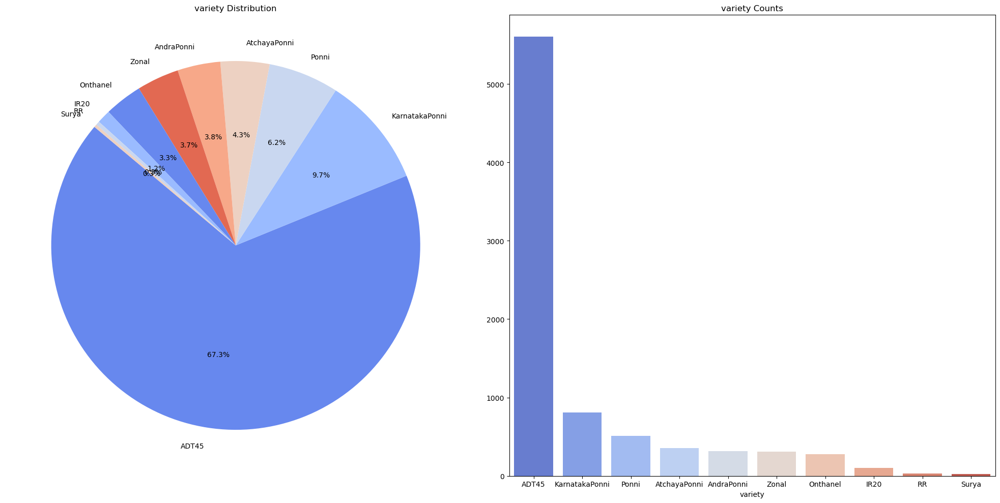

In [181]:
visualize_category_distribution(train_df, "variety")

In [182]:
train_df["variety"].value_counts()

variety
ADT45             5601
KarnatakaPonni     809
Ponni              513
AtchayaPonni       357
AndraPonni         313
Zonal              308
Onthanel           276
IR20                99
RR                  28
Surya               21
Name: count, dtype: int64

#### 3.3) Handle Imbalance in `Variety` Distribution

The above pie chart provides us with the current distribution of the variety, where some varieties like ⁣`Surya`, `RR` , and `IR20` only account for under or equal to 1%, while certain varieties such as `ADT45` dominate the dataset.

To address this issue, we applied some **offline image augmentations** to increase the number of images for minority classes. The intensity of augmentation is based on the frequency tier of each variety. The logic is implemented in the `df_augmentation()` for a simple workflow.

| Tier                          | Variety Names                                     | Applied Augmentations                                                                             |
| ----------------------------- | ------------------------------------------------- | --------------------------------------------------------------------------------------------------|
| **Very Low (< 50 samples)**   | `Surya`, `RR`                                     | Rotation (±5°, ±10°, ±15°), Horizontal Flip, Vertical Flip, Brightness ±20%, Zoom-in Crop, Cutout |
| **Low (50–120 samples)**      | `IR20`                                            | Rotation (±5°, ±10°), Brightness ±20%                                                             |    
| **Mid-Low (120–400 samples)** | `Onthanel`, `AndraPonni`, `Zonal`, `AtchayaPonni` | Rotation (±5°), Random Crop                                                                       |
| **Mid (400–1000 samples)**     | `Ponni`, `KarnatakaPonni`                         | Rotation (±5°)                                                                                    |

With this approach we can diverse training sample for minority class. This preprocessing is expected to improve both accuracy and robustness in **Task 2 (Variety Classification)**


In [183]:
augmented_df, augmented_count = df_augmentation(train_df)

Generating augmentations: 100%|██████████| 8325/8325 [00:19<00:00, 432.22it/s]

+------------------------------------------+
|           AUGMENTATION SUMMARY           |
+------------------------------------------+
Original dataset: 8325 images
Augmented dataset: 15913 images
Added 7588 augmented images


In [184]:
print_header("Augmentation Summary for Varieties:")
for variety, count in sorted(augmented_count.items(), key=lambda x: x[1], reverse=True):
    original_count = train_df[train_df["variety"] == variety].shape[0]
    new_count = original_count + count
    print(f"- {variety}: +{count} new images (now {new_count} total)")

+---------------------------------------------------------+
|           AUGMENTATION SUMMARY FOR VARIETIES:           |
+---------------------------------------------------------+
- KarnatakaPonni: +1618 new images (now 2427 total)
- AtchayaPonni: +1071 new images (now 1428 total)
- Ponni: +1026 new images (now 1539 total)
- AndraPonni: +939 new images (now 1252 total)
- Zonal: +924 new images (now 1232 total)
- Onthanel: +828 new images (now 1104 total)
- IR20: +594 new images (now 693 total)
- RR: +336 new images (now 364 total)
- Surya: +252 new images (now 273 total)


In [185]:
augmented_df = pd.read_csv("inputs/meta_train_augmented.csv")

augmented_df

,image_id,label,variety,age,image_path
0,109387.jpg,blast,AtchayaPonni,50,./inputs/train_images/blast/109387.jpg
1,109428.jpg,bacterial_leaf_blight,ADT45,72,./inputs/train_images/bacterial_leaf_blight/10...
2,105846.jpg,brown_spot,ADT45,55,./inputs/train_images/brown_spot/105846.jpg
3,104475.jpg,blast,ADT45,70,./inputs/train_images/blast/104475.jpg
4,102822.jpg,bacterial_leaf_streak,ADT45,68,./inputs/train_images/bacterial_leaf_streak/10...
...,...,...,...,...,...
15908,105389_rot_5.jpg,dead_heart,Onthanel,50,./inputs/train_augmented_images/dead_heart/105...
15909,105389_crop_resize.jpg,dead_heart,Onthanel,50,./inputs/train_augmented_images/dead_heart/105...
15910,108747_rot_-5.jpg,hispa,AtchayaPonni,65,./inputs/train_augmented_images/hispa/108747_r...
15911,108747_rot_5.jpg,hispa,AtchayaPonni,65,./inputs/train_augmented_images/hispa/108747_r...


+------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR VERY LOW (<50) TIER - VARIETY: SURYA           |
+------------------------------------------------------------------------------------+


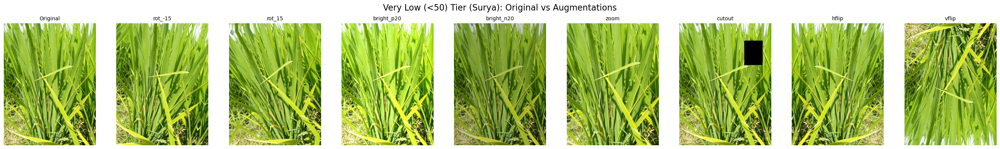

+---------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR LOW (50-120) TIER - VARIETY: IR20           |
+---------------------------------------------------------------------------------+


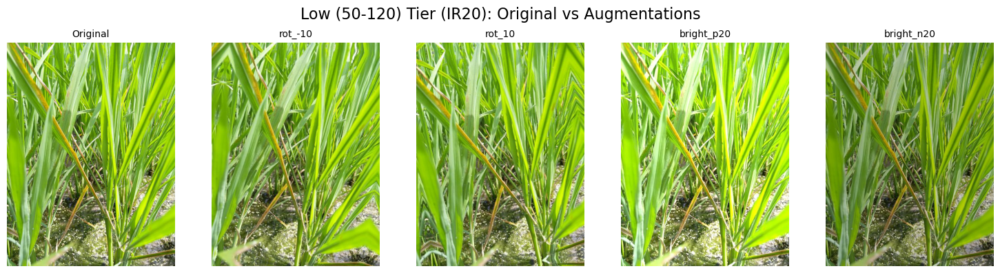

+------------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR MID-LOW (120-400) TIER - VARIETY: ONTHANEL           |
+------------------------------------------------------------------------------------------+


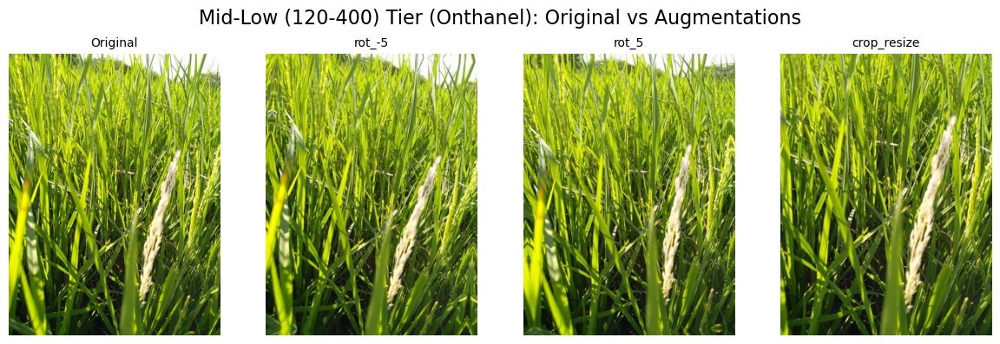

+------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR MID (400-1000) TIER - VARIETY: PONNI           |
+------------------------------------------------------------------------------------+


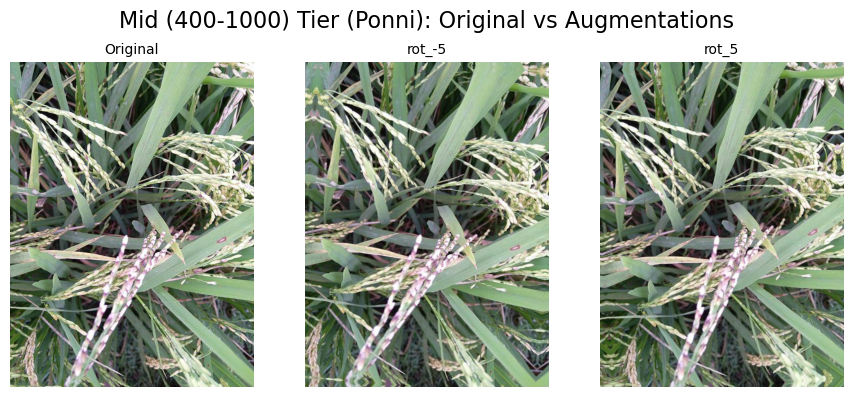

In [186]:
tiers = {
    "Very Low (<50)": ["Surya", "RR"],
    "Low (50-120)": ["IR20"],
    "Mid-Low (120-400)": ["Onthanel", "AndraPonni", "Zonal", "AtchayaPonni"],
    "Mid (400-1000)": ["Ponni", "KarnatakaPonni"],
}

augmentations = {
    "Very Low (<50)": [
        "rot_-15",
        "rot_15",
        "bright_p20",
        "bright_n20",
        "zoom",
        "cutout",
        "hflip",
        "vflip",
    ],
    "Low (50-120)": ["rot_-10", "rot_10", "bright_p20", "bright_n20"],
    "Mid-Low (120-400)": ["rot_-5", "rot_5", "crop_resize"],
    "Mid (400-1000)": ["rot_-5", "rot_5"],
}
display_augmentation_examples(train_df, augmented_df, tiers, augmentations)

After applying offline augmentation to minority classes, the variety distribution become **more balanced**. The most dominant class `ADT45` has been reduced from **65%** to only around **35%**, while the percentages of minority classes such as `Surya`, `RR`, and `IR20` have increased their proportions. This adjustments will reduce model bias and enhance accuracy of variety classification in **Task 2**. 

However, the number of maximum variety is 5601 (`ADT45`), while the lowest variety `Surya` is only 273. It is still not enough for models to predict without bias in the domain class. To address the remaining imbalance, we apply **semi-supervised learning** to further expand the dataset.

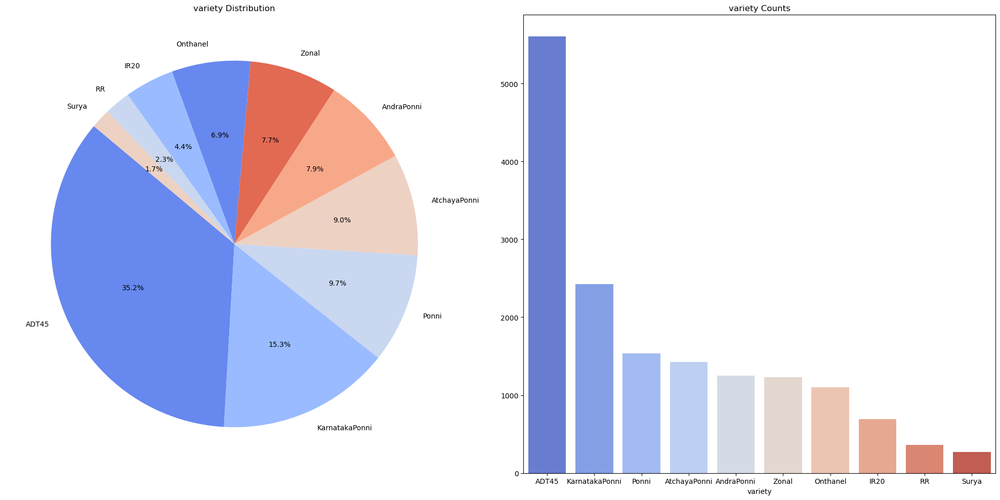

In [189]:
visualize_category_distribution(augmented_df, "variety")

In [190]:
print_header("The total number of each variety after augmenting")
augmented_df["variety"].value_counts()

+-----------------------------------------------------------------------+
|           THE TOTAL NUMBER OF EACH VARIETY AFTER AUGMENTING           |
+-----------------------------------------------------------------------+


variety
ADT45             5601
KarnatakaPonni    2427
Ponni             1539
AtchayaPonni      1428
AndraPonni        1252
Zonal             1232
Onthanel          1104
IR20               693
RR                 364
Surya              273
Name: count, dtype: int64

#### 3.4) Semi-supervised Learning